# How to Run the Final Project - Kuchan / Satya 

## Notebook header and goals

In [1]:
# final-project.ipynb
# ECE5831 Final Project: Traffic Sign Classification + Context-Aware Scene Description
# This notebook is a step-by-step validation workbook for the project pipeline.
# It verifies GPU availability and core environment settings before running each stage.

## Basic environment info

In [2]:
import os
import sys
import platform
from datetime import datetime

print("Timestamp:", datetime.now())
print("Python:", sys.version)
print("Platform:", platform.platform())
print("Working directory:", os.getcwd())


Timestamp: 2025-12-15 18:25:23.980829
Python: 3.10.12 (main, Nov  4 2025, 08:48:33) [GCC 11.4.0]
Platform: Linux-6.6.87.2-microsoft-standard-WSL2-x86_64-with-glibc2.35
Working directory: /home/kyuchan/ece5831_final


## TensorFlow GPU check + memory growth

In [3]:
import tensorflow as tf

print("TensorFlow version:", tf.__version__)

gpus = tf.config.list_physical_devices("GPU")
print("GPUs detected:", gpus)

if gpus:
    try:
        for g in gpus:
            tf.config.experimental.set_memory_growth(g, True)
        print("GPU memory growth: enabled")
    except Exception as e:
        print("WARNING: could not enable memory growth:", e)

# Confirm logical GPUs
logical_gpus = tf.config.list_logical_devices("GPU")
print("Logical GPUs:", logical_gpus)


2025-12-15 18:25:28.462598: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-15 18:25:28.801615: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-12-15 18:25:28.801842: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-12-15 18:25:28.867744: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-12-15 18:25:28.982254: I tensorflow/core/platform/cpu_feature_guar

TensorFlow version: 2.15.1
GPUs detected: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
GPU memory growth: enabled
Logical GPUs: [LogicalDevice(name='/device:GPU:0', device_type='GPU')]


2025-12-15 18:25:31.431184: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-15 18:25:31.877223: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-15 18:25:31.877267: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-15 18:25:31.879742: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-12-15 18:25:31.879781: I external/local_xla/xla/stream_executor

## Quick GPU compute sanity test

In [4]:
import time
import numpy as np
import tensorflow as tf

# A small matmul to confirm TensorFlow can execute with GPU
a = tf.random.uniform((2048, 2048), dtype=tf.float32)
b = tf.random.uniform((2048, 2048), dtype=tf.float32)

# Warm-up
_ = tf.matmul(a, b)

t0 = time.time()
c = tf.matmul(a, b)
_ = c.numpy()  # force synchronization
t1 = time.time()

print("MatMul output shape:", c.shape)
print("Elapsed seconds:", round(t1 - t0, 4))
print("Device for matmul:", c.device)


MatMul output shape: (2048, 2048)
Elapsed seconds: 0.1553
Device for matmul: /job:localhost/replica:0/task:0/device:GPU:0


## Versions of key libraries used in the project

In [5]:
import numpy as np
import pandas as pd
import sklearn
import matplotlib
import PIL

print("NumPy:", np.__version__)
print("Pandas:", pd.__version__)
print("scikit-learn:", sklearn.__version__)
print("Matplotlib:", matplotlib.__version__)
print("Pillow:", PIL.__version__)


NumPy: 1.26.4
Pandas: 2.3.3
scikit-learn: 1.7.2
Matplotlib: 3.10.8
Pillow: 12.0.0


## Imports and notebook-safe Matplotlib setup for inspect_mtsd.py

In [6]:
# Import standard libraries for JSON parsing and sampling.
import json  # JSON loading for annotation files.
import random  # Random sampling for quick checks.
import math  # Math utilities for grid sizing.
from pathlib import Path  # Path handling for cross-platform file paths.

# Import Matplotlib and force a notebook-friendly backend.
import matplotlib  # Matplotlib backend configuration.
matplotlib.use("Agg")  # Use a non-interactive backend to avoid Qt errors in notebooks.

# Import plotting utilities and patches for bounding boxes.
import matplotlib.pyplot as plt  # Plotting API for images and figures.
import matplotlib.patches as patches  # Rectangle patch for bounding box visualization.

# Import PIL for image loading and cropping.
from PIL import Image  # PIL image loader and crop utilities.

# Print a short status message for verification.
print("Notebook Matplotlib backend:", matplotlib.get_backend())  # Confirm backend for safety.


Notebook Matplotlib backend: Agg


## Configuration

In [7]:
# Set the project root as the current working directory.
PROJECT_ROOT = Path(".")  # Root path for the repository.

# Define the raw dataset root folder.
RAW_ROOT = PROJECT_ROOT / "data" / "raw" / "mtsd_extracted"  # Raw root path.

# Define the dataset root under the Annotation folder.
DATASET_ROOT = RAW_ROOT / "Annotation" / "mtsd_v2_fully_annotated"  # Annotation root.

# Define the annotation directory where JSON files exist.
ANN_DIR = DATASET_ROOT / "annotations"  # Folder containing <key>.json files.

# Define the splits directory (not used for loading images, but kept for checks).
SPLITS_DIR = DATASET_ROOT / "splits"  # Split metadata folder.

# Define the unified images folder.
DATASET_IMAGES_DIR = RAW_ROOT / "Dataset" / "images"  # Folder containing <key>.jpg images.

# Define the image extension used in the dataset.
IMAGE_EXT = ".jpg"  # Image extension.

# Define the excluded label string.
EXCLUDE_LABEL = "other-sign"  # Exclude label for inspection and later dataset building.

# Define how many keys to sample for matching checks.
MATCH_SAMPLE_N = 300  # Number of random keys to check for existence.

# Define how many examples to visualize.
PLOT_SAMPLES_N = 2  # Reduce default to avoid too many plots in a notebook.

# Enable crop visualization in the same figure.
SHOW_CROPS = True  # Show crops grid under the full image.

# Define bounding box visualization style.
BOX_COLOR = "red"  # Bounding box edge color.
BOX_LINEWIDTH = 2.5  # Bounding box line width.
BOX_FILL = False  # Do not fill the bounding box.

# Define crop panel grid layout.
CROP_GRID_COLS = 6  # Number of columns in the crop grid.

# Define crop label font size.
CROP_LABEL_FONTSIZE = 8  # Title font size for each crop.

# Print key configuration paths for quick verification.
print("RAW_ROOT:", RAW_ROOT)  # Print raw root path.
print("ANN_DIR:", ANN_DIR)  # Print annotation directory path.
print("DATASET_IMAGES_DIR:", DATASET_IMAGES_DIR)  # Print images directory path.
print("EXCLUDE_LABEL:", EXCLUDE_LABEL)  # Print excluded label.


RAW_ROOT: data/raw/mtsd_extracted
ANN_DIR: data/raw/mtsd_extracted/Annotation/mtsd_v2_fully_annotated/annotations
DATASET_IMAGES_DIR: data/raw/mtsd_extracted/Dataset/images
EXCLUDE_LABEL: other-sign


## Helper functions (copied logic, notebook-friendly typing)

In [8]:
# List annotation keys from ANN_DIR.
def list_annotation_keys() -> list[str]:
    # Raise an error if the annotation directory does not exist.
    if not ANN_DIR.exists():  # Check annotation directory existence.
        raise FileNotFoundError(f"Annotation directory not found: {ANN_DIR}")  # Raise error.
    # Collect all JSON stems as keys.
    keys = []  # Initialize key list.
    for p in ANN_DIR.glob("*.json"):  # Iterate over JSON files.
        keys.append(p.stem)  # Add file stem.
    return keys  # Return list of keys.

# Locate image path for a key under the unified folder.
def locate_image_path(image_key: str) -> Path | None:
    # Build the expected image path.
    p = DATASET_IMAGES_DIR / f"{image_key}{IMAGE_EXT}"  # Construct full image path.
    return p if p.exists() else None  # Return path if exists, else None.

# Locate annotation path for a key.
def locate_annotation_path(image_key: str) -> Path | None:
    # Build the expected annotation path.
    p = ANN_DIR / f"{image_key}.json"  # Construct full annotation path.
    return p if p.exists() else None  # Return path if exists, else None.

# Load JSON file content.
def load_json(path: Path) -> dict:
    # Open and parse JSON with UTF-8 encoding.
    with open(path, "r", encoding="utf-8") as f:  # Open file.
        return json.load(f)  # Parse JSON.

# Summarize important schema fields for inspection.
def summarize_annotation_schema(anno: dict) -> dict:
    # Return a compact dictionary for quick inspection.
    return {  # Build summary dict.
        "width": anno.get("width"),  # Image width.
        "height": anno.get("height"),  # Image height.
        "ispano": anno.get("ispano"),  # Panorama indicator.
        "objects_count": len(anno.get("objects", [])) if isinstance(anno.get("objects", []), list) else None,  # Count.
    }  # End dict.

# Extract list of object dictionaries from annotation.
def extract_objects(anno: dict) -> list[dict]:
    # Read objects field.
    objs = anno.get("objects", [])  # Get objects list.
    # Return empty list if malformed.
    if not isinstance(objs, list):  # Validate list type.
        return []  # Return empty.
    # Filter to dict items only.
    return [o for o in objs if isinstance(o, dict)]  # Return only dict objects.

# Extract bbox from an object dictionary.
def extract_bbox(obj: dict):
    # Get bbox dict.
    bbox = obj.get("bbox")  # Read bbox.
    # Return None if missing or invalid type.
    if not isinstance(bbox, dict):  # Validate bbox type.
        return None  # Return None.
    # Check required keys.
    if all(k in bbox for k in ["xmin", "ymin", "xmax", "ymax"]):  # Validate required keys.
        xmin = float(bbox["xmin"])  # Convert xmin.
        ymin = float(bbox["ymin"])  # Convert ymin.
        xmax = float(bbox["xmax"])  # Convert xmax.
        ymax = float(bbox["ymax"])  # Convert ymax.
        return xmin, ymin, xmax, ymax, bbox.get("cross_boundary")  # Return bbox with cross boundary.
    # Return None if missing keys.
    return None  # Return None.

# Clamp bbox to image boundaries.
def clamp_bbox(xmin, ymin, xmax, ymax, w, h):
    # Clamp coordinates to valid range.
    xmin = max(0, min(xmin, w - 1))  # Clamp xmin.
    ymin = max(0, min(ymin, h - 1))  # Clamp ymin.
    xmax = max(0, min(xmax, w - 1))  # Clamp xmax.
    ymax = max(0, min(ymax, h - 1))  # Clamp ymax.
    # Reject empty or invalid boxes.
    if xmax <= xmin or ymax <= ymin:  # Check box validity.
        return None  # Return None if invalid.
    return xmin, ymin, xmax, ymax  # Return clamped bbox.

# Check if label should be excluded.
def is_excluded_label(label: str) -> bool:
    # Compare after converting to string and stripping whitespace.
    return str(label).strip() == EXCLUDE_LABEL  # Return True if excluded.


## Directory existence checks (safe, no plotting)

In [9]:
# Print basic directory existence checks for early debugging.
print(f"[CHECK] RAW_ROOT exists = {RAW_ROOT.exists()} -> {RAW_ROOT}")  # Check raw root.
print(f"[CHECK] DATASET_ROOT exists = {DATASET_ROOT.exists()} -> {DATASET_ROOT}")  # Check dataset root.
print(f"[CHECK] ANN_DIR exists = {ANN_DIR.exists()} -> {ANN_DIR}")  # Check annotation directory.
print(f"[CHECK] SPLITS_DIR exists = {SPLITS_DIR.exists()} -> {SPLITS_DIR}")  # Check splits directory.
print(f"[CHECK] DATASET_IMAGES_DIR exists = {DATASET_IMAGES_DIR.exists()} -> {DATASET_IMAGES_DIR}")  # Check image dir.
print(f"[INFO] Excluding label = '{EXCLUDE_LABEL}'")  # Print excluded label.


[CHECK] RAW_ROOT exists = True -> data/raw/mtsd_extracted
[CHECK] DATASET_ROOT exists = True -> data/raw/mtsd_extracted/Annotation/mtsd_v2_fully_annotated
[CHECK] ANN_DIR exists = True -> data/raw/mtsd_extracted/Annotation/mtsd_v2_fully_annotated/annotations
[CHECK] SPLITS_DIR exists = True -> data/raw/mtsd_extracted/Annotation/mtsd_v2_fully_annotated/splits
[CHECK] DATASET_IMAGES_DIR exists = True -> data/raw/mtsd_extracted/Dataset/images
[INFO] Excluding label = 'other-sign'


## Load keys and run matching sanity check

In [10]:
# Load all annotation keys.
keys_all = list_annotation_keys()  # Get all keys.
print(f"[INFO] Total annotation keys found = {len(keys_all)}")  # Print count.

# Sample keys for matching checks.
sample = random.sample(keys_all, k=min(MATCH_SAMPLE_N, len(keys_all)))  # Random sample.

# Initialize counters for file checks.
img_ok = 0  # Count images found.
ann_ok = 0  # Count annotations found.
both_ok = 0  # Count both found.

# Loop through sampled keys and verify existence.
for k in sample:  # Iterate sampled keys.
    img_path = locate_image_path(k)  # Locate image.
    ann_path = locate_annotation_path(k)  # Locate annotation.
    if img_path is not None:  # If image exists.
        img_ok += 1  # Increment.
    if ann_path is not None:  # If annotation exists.
        ann_ok += 1  # Increment.
    if img_path is not None and ann_path is not None:  # If both exist.
        both_ok += 1  # Increment.

# Print matching check summary.
print("[MATCH] Verifying image_key -> (image file, annotation file) existence...")  # Print header.
print(f"  - checked={len(sample)}, images_found={img_ok}, annos_found={ann_ok}, both_found={both_ok}")  # Print stats.


[INFO] Total annotation keys found = 41909
[MATCH] Verifying image_key -> (image file, annotation file) existence...
  - checked=300, images_found=300, annos_found=300, both_found=300


## Inspect schema of a few random annotation files

In [11]:
# Sample a few keys for schema inspection.
schema_keys = random.sample(keys_all, k=min(5, len(keys_all)))  # Choose up to 5 keys.
print("[SCHEMA] Showing top-level keys for random annotation JSON files...")  # Print header.

# Loop through the sampled keys and print schema information.
for k in schema_keys:  # Iterate keys.
    ann_path = locate_annotation_path(k)  # Locate annotation path.
    if ann_path is None:  # Skip if missing.
        continue  # Continue.
    anno = load_json(ann_path)  # Load JSON.
    top_keys = list(anno.keys())  # Get top-level keys.
    print(f"  - {k}.json: keys={top_keys[:20]}{'...' if len(top_keys) > 20 else ''}")  # Print keys preview.
    print(f"    summary={summarize_annotation_schema(anno)}")  # Print summary dict.


[SCHEMA] Showing top-level keys for random annotation JSON files...
  - TnVxzVOEGuG5l95wa3P35g.json: keys=['width', 'height', 'ispano', 'objects']
    summary={'width': 3264, 'height': 2448, 'ispano': False, 'objects_count': 2}
  - U-kWL2X61uztVJ9tnW-TeA.json: keys=['width', 'height', 'ispano', 'objects']
    summary={'width': 1920, 'height': 1080, 'ispano': False, 'objects_count': 1}
  - 7-nG7teLS9Xw9EYUyyRO1A.json: keys=['width', 'height', 'ispano', 'objects']
    summary={'width': 4032, 'height': 3024, 'ispano': False, 'objects_count': 4}
  - WqIVMQIOCHzaTel299wGFQ.json: keys=['width', 'height', 'ispano', 'objects']
    summary={'width': 1920, 'height': 1080, 'ispano': False, 'objects_count': 3}
  - 1lxTw3iKI1lRXiuv-X9tzQ.json: keys=['width', 'height', 'ispano', 'objects']
    summary={'width': 3840, 'height': 2160, 'ispano': False, 'objects_count': 3}


## Notebook-safe visualization function (no Qt pop-up, saves and shows inline)

In [12]:
# Plot a full image with bbox overlays and all crops in a grid, and show inline.
def plot_image_and_all_crops_inline(image_path: Path, anno: dict, title: str):
    # Load the full image in RGB.
    img = Image.open(image_path).convert("RGB")  # Load image.
    w, h = img.size  # Read width and height.

    # Extract object list from the annotation.
    objs = extract_objects(anno)  # Extract objects.

    # Prepare lists for valid boxes and labels.
    boxes = []  # Store clamped boxes.
    labels = []  # Store labels.

    # Iterate over objects and keep only valid bboxes not excluded.
    for obj in objs:  # Loop objects.
        lbl = obj.get("label", "unknown")  # Read label.
        if is_excluded_label(lbl):  # Skip excluded label.
            continue  # Continue.
        out = extract_bbox(obj)  # Extract bbox.
        if out is None:  # Skip if missing.
            continue  # Continue.
        xmin, ymin, xmax, ymax, cross_boundary = out  # Unpack bbox.
        if cross_boundary is not None and xmin > xmax:  # Skip panorama wrap-around.
            continue  # Continue.
        clamped = clamp_bbox(xmin, ymin, xmax, ymax, w, h)  # Clamp bbox.
        if clamped is None:  # Skip invalid.
            continue  # Continue.
        boxes.append(clamped)  # Append bbox.
        labels.append(lbl)  # Append label.

    # Compute crop grid dimensions.
    n_crops = len(boxes) if SHOW_CROPS else 0  # Number of crops.
    if SHOW_CROPS and n_crops > 0:  # If crops exist.
        cols = max(1, CROP_GRID_COLS)  # Columns.
        rows = int(math.ceil(n_crops / cols))  # Rows.
    else:  # No crops case.
        cols = 1  # Default cols.
        rows = 1  # Default rows.

    # Create a figure with adaptive size.
    fig_w = 14  # Figure width.
    fig_h = 6 + (rows * 2.4 if SHOW_CROPS and n_crops > 0 else 0)  # Figure height.
    fig = plt.figure(figsize=(fig_w, fig_h))  # Create figure.

    # Create gridspec layout for top image and bottom crops panel.
    if SHOW_CROPS:  # If showing crops.
        gs = fig.add_gridspec(2, 1, height_ratios=[4, max(1.0, rows * 1.8)])  # Define grid.
        ax_img = fig.add_subplot(gs[0])  # Top axis.
        ax_crops_container = fig.add_subplot(gs[1])  # Bottom axis.
    else:  # No crops mode.
        ax_img = fig.add_subplot(1, 1, 1)  # Single axis.
        ax_crops_container = None  # No crops axis.

    # Plot full image.
    ax_img.imshow(img)  # Show image.
    ax_img.set_title(title)  # Set title.
    ax_img.axis("off")  # Hide axes.

    # Draw bounding boxes.
    for (xmin, ymin, xmax, ymax) in boxes:  # Loop boxes.
        rect = patches.Rectangle(  # Create rectangle.
            (xmin, ymin),  # Bottom-left corner.
            xmax - xmin,  # Width.
            ymax - ymin,  # Height.
            fill=BOX_FILL,  # Fill.
            linewidth=BOX_LINEWIDTH,  # Line width.
            edgecolor=BOX_COLOR,  # Edge color.
        )  # End rectangle.
        ax_img.add_patch(rect)  # Add patch.

    # Plot crop grid if enabled.
    if SHOW_CROPS and ax_crops_container is not None:  # If crops container exists.
        ax_crops_container.axis("off")  # Hide axes.
        if n_crops == 0:  # No crops case.
            ax_crops_container.set_title("No valid crops found.")  # Title.
        else:  # Crops exist.
            for idx, ((xmin, ymin, xmax, ymax), cls) in enumerate(zip(boxes, labels)):  # Loop crops.
                r = idx // cols  # Row index.
                c = idx % cols  # Col index.
                cell_w = 1.0 / cols  # Cell width in axis coordinates.
                cell_h = 1.0 / rows  # Cell height in axis coordinates.
                left = c * cell_w + 0.01  # Left margin.
                bottom = 1.0 - (r + 1) * cell_h + 0.06  # Bottom margin.
                width = cell_w - 0.02  # Inset width.
                height = cell_h - 0.10  # Inset height.
                inset = ax_crops_container.inset_axes([left, bottom, width, height])  # Create inset axis.
                crop = img.crop((xmin, ymin, xmax, ymax))  # Crop region.
                inset.imshow(crop)  # Show crop.
                inset.set_title(str(cls), fontsize=CROP_LABEL_FONTSIZE)  # Label title.
                inset.axis("off")  # Hide axes.

    # Tight layout and show inline.
    plt.tight_layout()  # Improve spacing.
    plt.show()  # Render inline in notebook.


## Plot a few random examples (safe count, no crash)

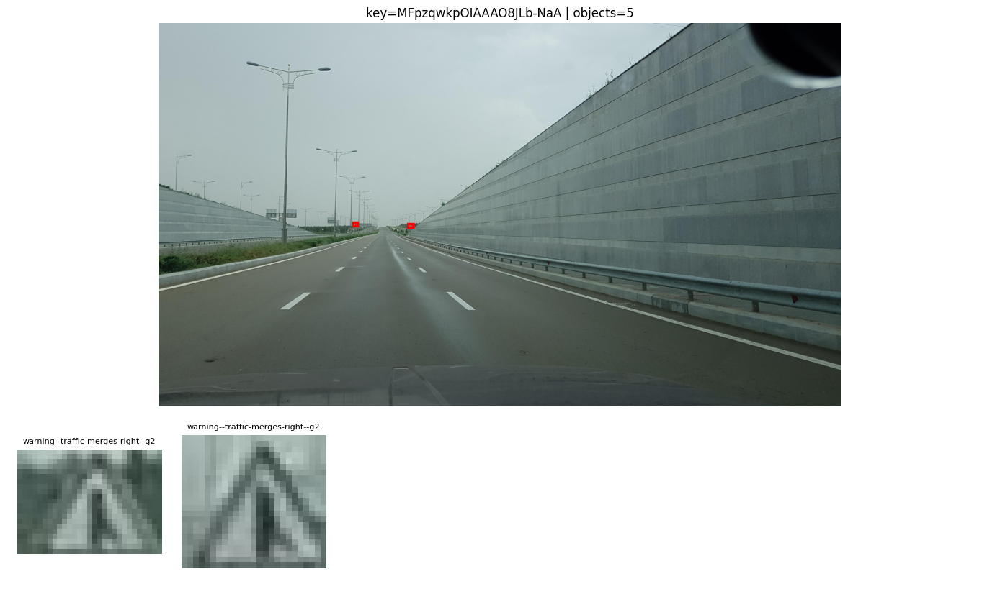

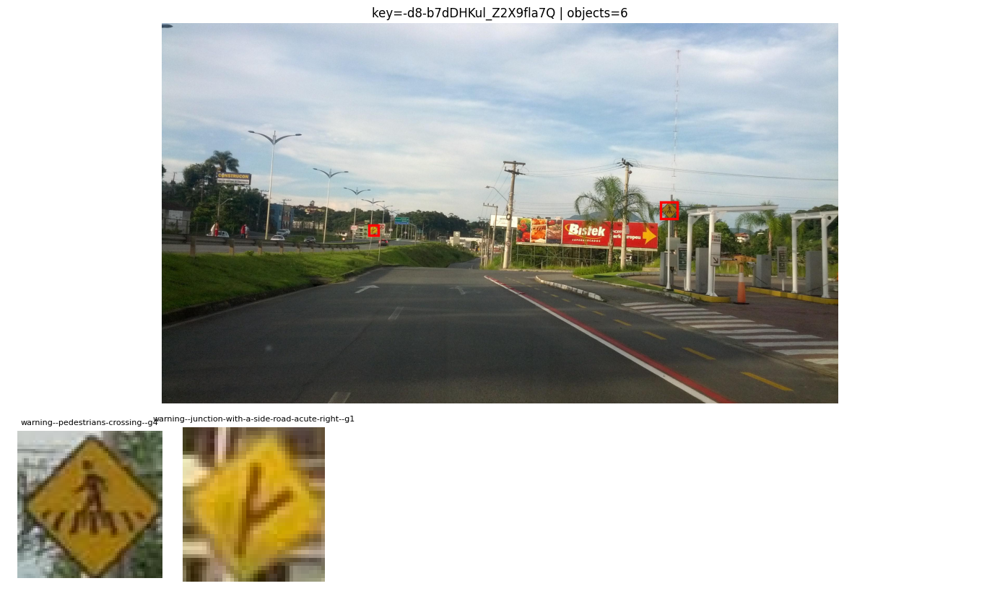

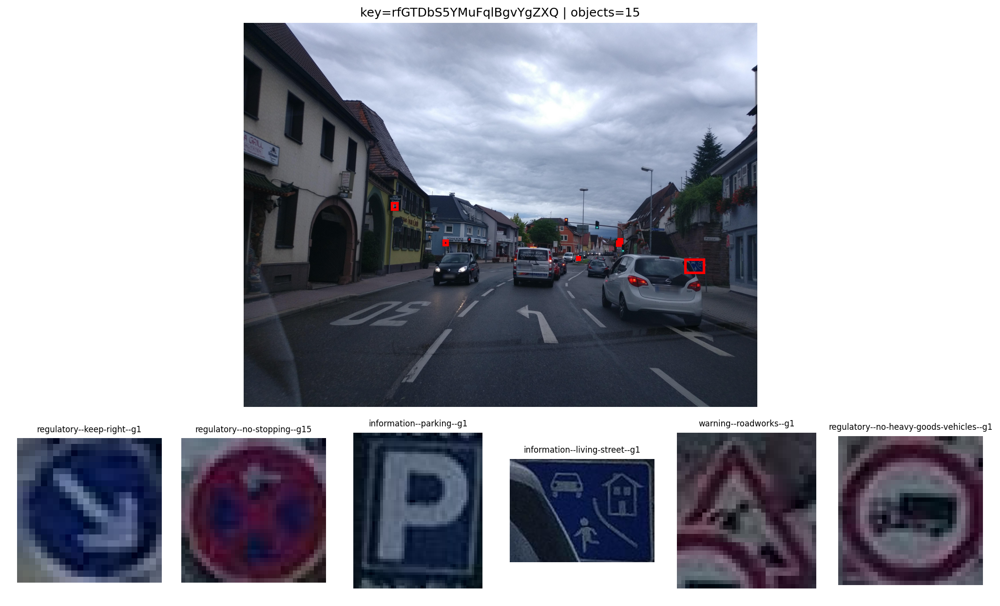

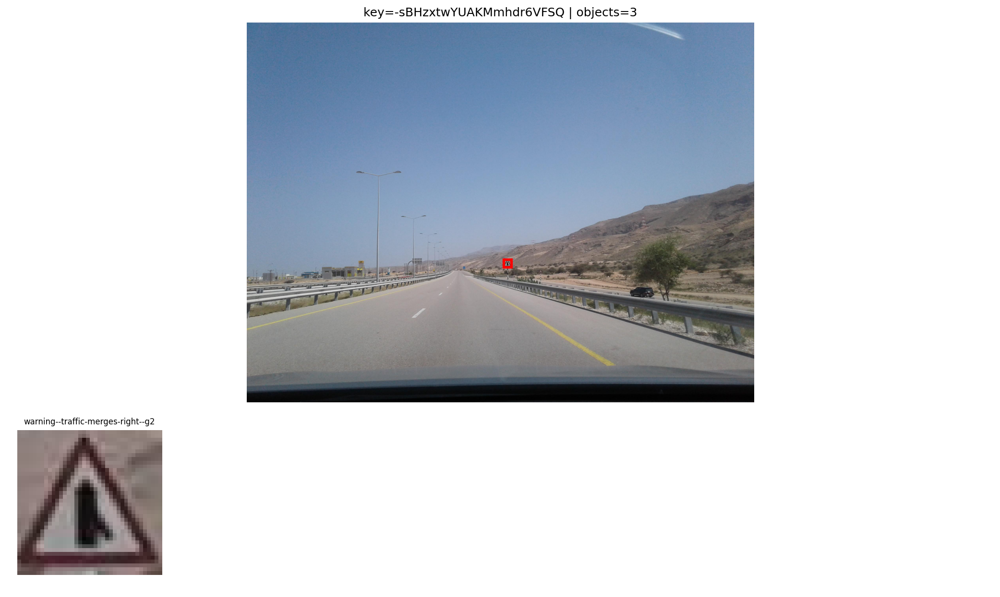

[DONE] Plotted 2 example(s).


In [15]:
# Import Matplotlib for plotting.
import matplotlib  # Matplotlib backend control.

# Do NOT force "Agg" in a Jupyter notebook.
# matplotlib.use("Agg")  # Disable this line in notebooks.

# Enable inline plotting in Jupyter.
%matplotlib inline
# Show plots inside the notebook.

# Import pyplot after backend is ready.
import matplotlib.pyplot as plt  # Plotting API.

# Optional: make plots a bit sharper in notebooks.
plt.rcParams["figure.dpi"] = 150  # Increase default display DPI.


# Choose a subset of keys to avoid scanning everything.
subset = random.sample(keys_all, k=min(2500, len(keys_all)))  # Candidate pool.
random.shuffle(subset)  # Shuffle in place.

# Initialize plotted counter.
plotted = 0  # Counter.

# Loop through subset and plot examples with valid matches.
for k in subset:  # Iterate keys.
    img_path = locate_image_path(k)  # Locate image.
    ann_path = locate_annotation_path(k)  # Locate annotation.
    if img_path is None or ann_path is None:  # Skip missing.
        continue  # Continue.
    anno = load_json(ann_path)  # Load annotation.
    title = f"key={k} | objects={len(extract_objects(anno))}"  # Build title.
    plot_image_and_all_crops_inline(img_path, anno, title)  # Plot inline.
    plotted += 1  # Increment.
    if plotted >= PLOT_SAMPLES_N:  # Stop after desired number.
        break  # Break.

# Print final status message.
if plotted == 0:  # If nothing plotted.
    print("[WARN] No matched samples found for plotting. Check folder structure.")  # Warning.
else:  # Plotted successfully.
    print(f"[DONE] Plotted {plotted} example(s).")  # Done message.


## Imports and basic setup for save_crops_csv.py

In [16]:
# Import standard libraries for JSON parsing and CSV writing.
import json  # For loading annotation JSON files.
import csv  # For writing CSV manifest files.
import re  # For sanitizing class labels.
from pathlib import Path  # For robust path handling.
from typing import Optional, Tuple, List, Dict, Any  # For type annotations.

# Import PIL for image loading and cropping.
from PIL import Image  # Image open and crop utilities.

# Import datetime to create unique output directories.
from datetime import datetime  # Timestamp generation.

# Print confirmation message.
print("Imports for crop generation practice loaded successfully.")


Imports for crop generation practice loaded successfully.


## Configuration (non-destructive notebook version)

In [17]:
# Define the project root as the current working directory.
PROJECT_ROOT = Path(".")  # Root of the repository.

# Define the raw dataset root directory.
RAW_ROOT = PROJECT_ROOT / "data" / "raw" / "mtsd_extracted"  # Raw dataset folder.

# Define the annotation dataset root.
DATASET_ROOT = RAW_ROOT / "Annotation" / "mtsd_v2_fully_annotated"  # Annotation root.

# Define the annotation directory.
ANN_DIR = DATASET_ROOT / "annotations"  # Folder containing annotation JSON files.

# Define the unified images directory.
IMAGES_DIR = RAW_ROOT / "Dataset" / "images"  # Folder containing image JPG files.

# Define the image extension.
IMAGE_EXT = ".jpg"  # Image file extension.

# Define the excluded label.
EXCLUDE_LABEL = "other-sign"  # Label to be excluded from crops and CSV.

# Create a unique output directory using timestamp to avoid overwriting.
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")  # Generate timestamp string.
OUT_DIR = PROJECT_ROOT / "data" / "processed" / f"mtsd_crop_practice_{timestamp}"  # Unique output directory.

# Print configuration for verification.
print("Annotation directory:", ANN_DIR)
print("Images directory:", IMAGES_DIR)
print("Excluded label:", EXCLUDE_LABEL)
print("Notebook output directory:", OUT_DIR)


Annotation directory: data/raw/mtsd_extracted/Annotation/mtsd_v2_fully_annotated/annotations
Images directory: data/raw/mtsd_extracted/Dataset/images
Excluded label: other-sign
Notebook output directory: data/processed/mtsd_crop_practice_20251215_184508


## Helper functions (copied logic, notebook-safe)

In [18]:
# List all annotation keys from the annotation directory.
def list_annotation_keys(ann_dir: Path) -> List[str]:
    # Raise error if annotation directory does not exist.
    if not ann_dir.exists():
        raise FileNotFoundError(f"Annotation directory not found: {ann_dir}")
    # Collect JSON file stems as keys.
    return [p.stem for p in ann_dir.glob("*.json")]

# Locate image file path given an image key.
def locate_image_path(images_dir: Path, image_key: str, image_ext: str) -> Optional[Path]:
    # Construct expected image path.
    p = images_dir / f"{image_key}{image_ext}"
    # Return path if it exists, otherwise None.
    return p if p.exists() else None

# Locate annotation file path given an image key.
def locate_annotation_path(ann_dir: Path, image_key: str) -> Optional[Path]:
    # Construct expected annotation path.
    p = ann_dir / f"{image_key}.json"
    # Return path if it exists, otherwise None.
    return p if p.exists() else None

# Load a JSON file and return its content.
def load_json(path: Path) -> Dict[str, Any]:
    # Open file with UTF-8 encoding.
    with open(path, "r", encoding="utf-8") as f:
        return json.load(f)

# Extract object list from annotation dictionary.
def extract_objects(anno: Dict[str, Any]) -> List[Dict[str, Any]]:
    # Read objects field.
    objs = anno.get("objects", [])
    # Return empty list if malformed.
    if not isinstance(objs, list):
        return []
    # Filter only dictionary objects.
    return [o for o in objs if isinstance(o, dict)]

# Extract bounding box from object dictionary.
def extract_bbox_xyxy(obj: Dict[str, Any]) -> Optional[Tuple[float, float, float, float, Any]]:
    # Read bbox field.
    bbox = obj.get("bbox")
    # Validate bbox structure.
    if not isinstance(bbox, dict):
        return None
    # Required bbox keys.
    required = ["xmin", "ymin", "xmax", "ymax"]
    if not all(k in bbox for k in required):
        return None
    # Parse coordinates.
    xmin = float(bbox["xmin"])
    ymin = float(bbox["ymin"])
    xmax = float(bbox["xmax"])
    ymax = float(bbox["ymax"])
    # Return bbox with cross-boundary metadata.
    return xmin, ymin, xmax, ymax, bbox.get("cross_boundary")

# Clamp bounding box to image boundaries.
def clamp_bbox_xyxy(xmin: float, ymin: float, xmax: float, ymax: float, w: int, h: int) -> Optional[Tuple[int, int, int, int]]:
    # Clamp coordinates.
    xmin = max(0.0, min(xmin, float(w - 1)))
    ymin = max(0.0, min(ymin, float(h - 1)))
    xmax = max(0.0, min(xmax, float(w - 1)))
    ymax = max(0.0, min(ymax, float(h - 1)))
    # Reject invalid boxes.
    if xmax <= xmin or ymax <= ymin:
        return None
    # Return integer coordinates.
    return int(xmin), int(ymin), int(xmax), int(ymax)

# Sanitize class label for safe filename usage.
def sanitize_label_for_filename(label: str) -> str:
    # Strip whitespace and convert to string.
    label = str(label).strip()
    # Replace whitespace with underscores.
    label = re.sub(r"\s+", "_", label)
    # Remove unsafe characters.
    label = re.sub(r"[^A-Za-z0-9_\-\.]", "_", label)
    # Return sanitized label.
    return label if label else "unknown"

# Check whether a label should be excluded.
def is_excluded_label(label: str) -> bool:
    # Compare label against excluded label.
    return str(label).strip() == EXCLUDE_LABEL


## Create output folders (safe, non-destructive)

In [19]:
# Create the output directory structure.
OUT_DIR.mkdir(parents=True, exist_ok=True)  # Create main output directory.
CROPS_DIR = OUT_DIR / "crops"  # Directory for cropped images.
CROPS_DIR.mkdir(parents=True, exist_ok=True)  # Create crops directory.

# Define CSV output path with a unique name.
CSV_PATH = OUT_DIR / f"crops_practice_{timestamp}.csv"  # Unique CSV filename.

# Print created paths for verification.
print("Crops directory:", CROPS_DIR)
print("CSV output path:", CSV_PATH)


Crops directory: data/processed/mtsd_crop_practice_20251215_184508/crops
CSV output path: data/processed/mtsd_crop_practice_20251215_184508/crops_practice_20251215_184508.csv


## Dry-run crop generation (limited keys, no overwrite)

In [20]:
# List all annotation keys.
keys_all = list_annotation_keys(ANN_DIR)  # Get all keys.
print("Total annotation keys:", len(keys_all))

# Limit number of images for notebook practice.
MAX_IMAGES_NOTEBOOK = 50  # Safety limit for practice.

# Select a subset of keys.
keys_subset = keys_all[:MAX_IMAGES_NOTEBOOK]  # Take first N keys.

# Prepare CSV field names.
fieldnames = [
    "crop_path",
    "label",
    "image_key",
    "image_path",
    "ann_path",
    "obj_index",
    "xmin",
    "ymin",
    "xmax",
    "ymax",
    "width",
    "height",
]

# Initialize counters.
saved_crops = 0  # Count saved crops.
skipped_excluded = 0  # Count excluded labels.

# Open CSV file for writing.
with open(CSV_PATH, "w", newline="", encoding="utf-8") as f_csv:
    writer = csv.DictWriter(f_csv, fieldnames=fieldnames)  # Create CSV writer.
    writer.writeheader()  # Write header row.

    # Iterate over selected image keys.
    for image_key in keys_subset:
        img_path = locate_image_path(IMAGES_DIR, image_key, IMAGE_EXT)  # Locate image.
        ann_path = locate_annotation_path(ANN_DIR, image_key)  # Locate annotation.
        if img_path is None or ann_path is None:
            continue  # Skip missing files.

        img = Image.open(img_path).convert("RGB")  # Load image.
        w, h = img.size  # Get image dimensions.

        anno = load_json(ann_path)  # Load annotation.
        objects = extract_objects(anno)  # Extract objects list.

        # Iterate over objects in the annotation.
        for obj_index, obj in enumerate(objects):
            label = obj.get("label", "unknown")  # Read label.
            if is_excluded_label(label):
                skipped_excluded += 1  # Count excluded.
                continue  # Skip.

            bbox_out = extract_bbox_xyxy(obj)  # Extract bbox.
            if bbox_out is None:
                continue  # Skip invalid bbox.

            xmin, ymin, xmax, ymax, cross_boundary = bbox_out  # Unpack bbox.
            if cross_boundary is not None and xmin > xmax:
                continue  # Skip panorama wrap-around.

            clamped = clamp_bbox_xyxy(xmin, ymin, xmax, ymax, w, h)  # Clamp bbox.
            if clamped is None:
                continue  # Skip invalid bbox.

            xmin_i, ymin_i, xmax_i, ymax_i = clamped  # Unpack clamped bbox.
            bw = xmax_i - xmin_i  # Compute width.
            bh = ymax_i - ymin_i  # Compute height.
            if bw < 2 or bh < 2:
                continue  # Skip too small crops.

            label_safe = sanitize_label_for_filename(label)  # Sanitize label.
            crop = img.crop((xmin_i, ymin_i, xmax_i, ymax_i))  # Crop image.

            # Create label-specific directory.
            label_dir = CROPS_DIR / label_safe  # Label directory path.
            label_dir.mkdir(parents=True, exist_ok=True)  # Create directory.

            # Create unique crop filename.
            crop_filename = f"{image_key}_obj{obj_index:03d}_{label_safe}.png"
            crop_path = label_dir / crop_filename

            # Save crop image.
            crop.save(crop_path)

            # Write metadata row to CSV.
            writer.writerow({
                "crop_path": str(crop_path),
                "label": label,
                "image_key": image_key,
                "image_path": str(img_path),
                "ann_path": str(ann_path),
                "obj_index": obj_index,
                "xmin": xmin_i,
                "ymin": ymin_i,
                "xmax": xmax_i,
                "ymax": ymax_i,
                "width": bw,
                "height": bh,
            })

            saved_crops += 1  # Increment saved crops.

# Print summary statistics.
print("Saved crops:", saved_crops)
print("Skipped excluded labels:", skipped_excluded)
print("CSV written to:", CSV_PATH)


Total annotation keys: 41909
Saved crops: 73
Skipped excluded labels: 113
CSV written to: data/processed/mtsd_crop_practice_20251215_184508/crops_practice_20251215_184508.csv


## Verify CSV content

In [21]:
# Import pandas for quick CSV inspection.
import pandas as pd  # CSV inspection.

# Load the generated CSV.
df = pd.read_csv(CSV_PATH)  # Read CSV file.

# Print basic CSV information.
print("CSV shape:", df.shape)
print("CSV columns:", list(df.columns))

# Display first few rows.
df.head()


CSV shape: (73, 12)
CSV columns: ['crop_path', 'label', 'image_key', 'image_path', 'ann_path', 'obj_index', 'xmin', 'ymin', 'xmax', 'ymax', 'width', 'height']


,crop_path,label,image_key,image_path,ann_path,obj_index,xmin,ymin,xmax,ymax,width,height
0,data/processed/mtsd_crop_practice_20251215_184...,regulatory--keep-right--g1,-3heY6kZhu6sy-09K82YsQ,data/raw/mtsd_extracted/Dataset/images/-3heY6k...,data/raw/mtsd_extracted/Annotation/mtsd_v2_ful...,0,1202,1678,1340,1811,138,133
1,data/processed/mtsd_crop_practice_20251215_184...,regulatory--go-straight--g1,zYMlkDRvOk17AIkWJmBarg,data/raw/mtsd_extracted/Dataset/images/zYMlkDR...,data/raw/mtsd_extracted/Annotation/mtsd_v2_ful...,0,2045,1742,2090,1790,45,48
2,data/processed/mtsd_crop_practice_20251215_184...,regulatory--no-entry--g1,zYMlkDRvOk17AIkWJmBarg,data/raw/mtsd_extracted/Dataset/images/zYMlkDR...,data/raw/mtsd_extracted/Annotation/mtsd_v2_ful...,1,2492,1689,2510,1732,18,43
3,data/processed/mtsd_crop_practice_20251215_184...,warning--pedestrians-crossing--g9,JbWm7B2K9odoZxTsLZRqTg,data/raw/mtsd_extracted/Dataset/images/JbWm7B2...,data/raw/mtsd_extracted/Annotation/mtsd_v2_ful...,0,2745,759,2858,880,113,121
4,data/processed/mtsd_crop_practice_20251215_184...,regulatory--road-closed--g1,MMNi2Zje3LCzE1O9cESMqg,data/raw/mtsd_extracted/Dataset/images/MMNi2Zj...,data/raw/mtsd_extracted/Annotation/mtsd_v2_ful...,0,1815,1709,1845,1735,30,26


## Imports and inline plotting setup for train_keras_signs.py

In [22]:
# Enable inline plotting for Jupyter notebooks.
%matplotlib inline 
# Show figures inside the notebook.

# Import standard libraries for filesystem and metadata handling.
import os  # OS utilities for environment variables.
import json  # JSON writing for class names.
from pathlib import Path  # Robust path handling.
from datetime import datetime  # Timestamp for unique run folder names.
from typing import Tuple, Dict, List  # Type annotations.

# Import numerical and dataframe libraries.
import numpy as np  # Numerical arrays and random generator.
import pandas as pd  # CSV loading and dataframe manipulation.

# Import plotting library for optional curve plotting.
import matplotlib.pyplot as plt  # Plotting training curves.

# Import TensorFlow and Keras for training.
import tensorflow as tf  # TensorFlow core.
from tensorflow import keras  # Keras high-level API.
from tensorflow.keras import layers  # Keras layers.

# Import metrics utilities for evaluation.
from sklearn.metrics import confusion_matrix, classification_report  # Confusion matrix and report.

# Print versions for reproducibility.
print("TensorFlow:", tf.__version__)  # Print TensorFlow version.
print("NumPy:", np.__version__)  # Print NumPy version.
print("Pandas:", pd.__version__)  # Print Pandas version.


TensorFlow: 2.15.1
NumPy: 1.26.4
Pandas: 2.3.3


## Notebook-safe configuration (VGG16 only, epochs = 1, unique outputs)

In [23]:
# Define the CSV path to the crop manifest.
CSV_PATH = Path("data/processed/mtsd_sign_crops_no_other_sign/crops.csv")  # Default full CSV path.

# Define an output root directory for training runs.
OUTPUT_ROOT = Path("outputs") / "notebook_train_runs"  # Notebook-specific output root.

# Define model input image size.
IMG_SIZE = (224, 224)  # Training input resolution.

# Define batch size.
BATCH_SIZE = 64  # Batch size used in training.

# Define epochs for notebook practice.
EPOCHS_NOTEBOOK = 1  # Only 1 epoch for notebook validation.

# Define learning rate for Adam optimizer.
LEARNING_RATE = 1e-4  # Learning rate.

# Define random seed for reproducibility.
SEED = 42  # Random seed.

# Define split ratios.
TRAIN_RATIO = 0.80  # Train ratio.
VAL_RATIO = 0.10  # Validation ratio.
TEST_RATIO = 0.10  # Test ratio.

# Fix the model name to VGG16 for notebook practice.
MODEL_NAME = "VGG16"  # Use only VGG16 in notebook.

# Define early stopping patience (kept for completeness, but epochs=1 makes it inactive).
EARLY_STOP_PATIENCE = 3  # Early stopping patience.

# Optional: limit dataset size for a fast notebook smoke test.
ENABLE_SUBSET_MODE = True  # Toggle to speed up notebook training.
MAX_ROWS_SUBSET = 2000  # Maximum number of rows to keep if subset mode is enabled.

# Print key configuration values.
print("MODEL_NAME:", MODEL_NAME)  # Print model choice.
print("EPOCHS_NOTEBOOK:", EPOCHS_NOTEBOOK)  # Print epoch setting.
print("ENABLE_SUBSET_MODE:", ENABLE_SUBSET_MODE)  # Print subset flag.
print("OUTPUT_ROOT:", OUTPUT_ROOT)  # Print output root.


MODEL_NAME: VGG16
EPOCHS_NOTEBOOK: 1
ENABLE_SUBSET_MODE: True
OUTPUT_ROOT: outputs/notebook_train_runs


## Utility functions (seed, run directory, CSV loading)

In [24]:
# Set random seeds for reproducibility.
def set_seed(seed: int) -> None:
    # Set TensorFlow random seed.
    tf.keras.utils.set_random_seed(seed)  # TensorFlow and NumPy seed sync.
    # Set Python hash seed for deterministic hashing.
    os.environ["PYTHONHASHSEED"] = str(seed)  # Hash seed.

# Create a unique run directory to avoid overwriting previous results.
def make_run_dir(root: Path, model_name: str) -> Path:
    # Create a timestamp string.
    ts = datetime.now().strftime("%Y%m%d_%H%M%S")  # Timestamp.
    # Create run directory name with timestamp and model name.
    run_dir = root / f"{ts}_{model_name}_notebook"  # Unique run directory.
    # Make directory if needed.
    run_dir.mkdir(parents=True, exist_ok=False)  # Fail if exists to avoid overwrite.
    # Return directory path.
    return run_dir  # Return run directory.

# Load crops CSV and validate required columns.
def load_crops_csv(path: Path) -> pd.DataFrame:
    # Raise error if CSV not found.
    if not path.exists():
        raise FileNotFoundError(f"CSV not found: {path}")
    # Read CSV.
    df = pd.read_csv(path)  # Load into dataframe.
    # Validate required columns.
    if "crop_path" not in df.columns or "label" not in df.columns:
        raise ValueError("CSV must contain at least 'crop_path' and 'label' columns.")
    # Keep only rows where crop files exist.
    df = df[df["crop_path"].map(lambda p: Path(str(p)).exists())].copy()  # Filter missing crops.
    # Normalize types.
    df["crop_path"] = df["crop_path"].astype(str)  # Ensure string paths.
    df["label"] = df["label"].astype(str)  # Ensure string labels.
    # Return dataframe.
    return df  # Return validated dataframe.


## Class-wise stratified split with duplication (same logic)

In [25]:
# Perform class-wise split with duplication for small classes.
def stratified_classwise_split_with_duplication(
    df: pd.DataFrame,
    train_r: float,
    val_r: float,
    test_r: float,
    seed: int,
) -> Tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame]:
    # Ensure split ratios sum to 1.
    assert abs(train_r + val_r + test_r - 1.0) < 1e-6  # Ratio check.
    # Create random generator.
    rng = np.random.default_rng(seed)  # NumPy RNG.

    # Create split parts lists.
    train_parts = []  # Train groups.
    val_parts = []  # Val groups.
    test_parts = []  # Test groups.

    # Group by label.
    for label, g in df.groupby("label"):  # Iterate each class group.
        g = g.sample(frac=1.0, random_state=seed).reset_index(drop=True)  # Shuffle group.
        n = len(g)  # Group size.

        # Compute per-class split sizes.
        val_n = int(round(n * val_r))  # Desired val count.
        test_n = int(round(n * test_r))  # Desired test count.
        val_n = max(1, val_n)  # Enforce at least 1 val.
        test_n = max(1, test_n)  # Enforce at least 1 test.

        # Compute train size as remainder.
        train_n = n - val_n - test_n  # Train count.
        if train_n < 1:  # Ensure at least 1 train.
            train_n = 1  # Force to 1.

        # Compute total needed samples for this class.
        total_needed = train_n + val_n + test_n  # Total per class.

        # Oversample if needed.
        if n < total_needed:  # If not enough samples.
            pick_idx = rng.integers(low=0, high=n, size=total_needed)  # Sample with replacement.
            g_expanded = g.iloc[pick_idx].copy().reset_index(drop=True)  # Expanded group.
        else:
            g_expanded = g.copy()  # Use original group.
            if len(g_expanded) > total_needed:  # Truncate if rounding overshoots.
                g_expanded = g_expanded.iloc[:total_needed].copy().reset_index(drop=True)  # Truncate.

        # Slice into train, val, test.
        g_train = g_expanded.iloc[:train_n].copy()  # Train slice.
        g_val = g_expanded.iloc[train_n:train_n + val_n].copy()  # Val slice.
        g_test = g_expanded.iloc[train_n + val_n:train_n + val_n + test_n].copy()  # Test slice.

        # Append to lists.
        train_parts.append(g_train)  # Append train.
        val_parts.append(g_val)  # Append val.
        test_parts.append(g_test)  # Append test.

    # Concatenate and shuffle final splits.
    df_train = pd.concat(train_parts, ignore_index=True).sample(frac=1.0, random_state=seed).reset_index(drop=True)  # Train.
    df_val = pd.concat(val_parts, ignore_index=True).sample(frac=1.0, random_state=seed).reset_index(drop=True)  # Val.
    df_test = pd.concat(test_parts, ignore_index=True).sample(frac=1.0, random_state=seed).reset_index(drop=True)  # Test.

    # Return splits.
    return df_train, df_val, df_test  # Return three splits.


## Build label map and tf.data pipelines

In [26]:
# Build label mapping from training split.
def build_label_map(df_train: pd.DataFrame) -> Tuple[Dict[str, int], List[str]]:
    # Get sorted unique labels.
    labels = sorted(df_train["label"].unique())  # Sorted labels.
    # Create label to index mapping.
    label_to_idx = {l: i for i, l in enumerate(labels)}  # Map labels to indices.
    # Return mapping and class list.
    return label_to_idx, labels  # Return mapping and list.

# Load and preprocess an image from path tensor.
def load_image(path: tf.Tensor) -> tf.Tensor:
    # Read raw bytes from file.
    img = tf.io.read_file(path)  # Read file.
    # Decode as RGB image.
    img = tf.image.decode_image(img, channels=3, expand_animations=False)  # Decode.
    # Resize to model input size.
    img = tf.image.resize(img, IMG_SIZE)  # Resize.
    # Convert to float32 in [0, 1].
    img = tf.image.convert_image_dtype(img, tf.float32)  # Normalize.
    # Return processed image tensor.
    return img  # Return tensor.

# Create tf.data dataset from dataframe.
def make_dataset(df: pd.DataFrame, label_map: Dict[str, int], training: bool) -> tf.data.Dataset:
    # Extract paths list.
    paths = df["crop_path"].astype(str).tolist()  # List of file paths.
    # Convert labels to integer indices.
    labels = [label_map[l] for l in df["label"].astype(str)]  # Label indices.
    # Create dataset from tensors.
    ds = tf.data.Dataset.from_tensor_slices((paths, labels))  # Base dataset.
    # Shuffle if training.
    if training:
        ds = ds.shuffle(buffer_size=len(paths), seed=SEED)  # Shuffle dataset.
    # Map preprocessing.
    ds = ds.map(lambda p, y: (load_image(p), y), num_parallel_calls=tf.data.AUTOTUNE)  # Preprocess.
    # Batch and prefetch.
    ds = ds.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)  # Batch and prefetch.
    # Return dataset.
    return ds  # Return tf.data dataset.


## Build VGG16 model (feature extractor + head)

In [27]:
# Get a pretrained backbone by name.
def get_backbone(model_name: str) -> keras.Model:
    # Return VGG16 backbone when requested.
    if model_name == "VGG16":
        return keras.applications.VGG16(include_top=False, weights="imagenet", input_shape=(*IMG_SIZE, 3))  # VGG16.
    # Raise error for unsupported names in notebook mode.
    raise ValueError(f"Unsupported model for notebook practice: {model_name}")

# Build the full classification model.
def build_model(model_name: str, num_classes: int) -> keras.Model:
    # Create backbone.
    backbone = get_backbone(model_name)  # Backbone model.
    # Freeze backbone weights.
    backbone.trainable = False  # Feature extractor only.

    # Define model input.
    inputs = keras.Input(shape=(*IMG_SIZE, 3))  # Input tensor.
    # Forward pass through backbone.
    x = backbone(inputs, training=False)  # Backbone features.
    # Global average pooling.
    x = layers.GlobalAveragePooling2D()(x)  # Pool features.
    # Dropout for regularization.
    x = layers.Dropout(0.3)(x)  # Dropout.
    # Final softmax classifier.
    outputs = layers.Dense(num_classes, activation="softmax")(x)  # Softmax head.

    # Create Keras model.
    model = keras.Model(inputs, outputs)  # Full model.
    # Compile model.
    model.compile(
        optimizer=keras.optimizers.Adam(LEARNING_RATE),  # Adam optimizer.
        loss="sparse_categorical_crossentropy",  # Loss function.
        metrics=["accuracy"],  # Training metric.
    )
    # Return compiled model.
    return model  # Return model.


## Load CSV, optional subset, split, and create datasets

In [28]:
# Set seeds for reproducibility.
set_seed(SEED)  # Seed all RNGs.

# Load crops CSV.
df = load_crops_csv(CSV_PATH)  # Load full dataset dataframe.

# Optionally reduce dataset size for notebook practice.
if ENABLE_SUBSET_MODE:
    df = df.sample(n=min(MAX_ROWS_SUBSET, len(df)), random_state=SEED).reset_index(drop=True)  # Subsample.
    print("Subset mode enabled. Rows used:", len(df))  # Print subset size.
else:
    print("Subset mode disabled. Rows used:", len(df))  # Print full size.

# Create class-wise splits.
df_train, df_val, df_test = stratified_classwise_split_with_duplication(df, TRAIN_RATIO, VAL_RATIO, TEST_RATIO, seed=SEED)  # Split.

# Build label mapping from training data.
label_map, class_names = build_label_map(df_train)  # Map labels.

# Create tf.data datasets.
train_ds = make_dataset(df_train, label_map, training=True)  # Training dataset.
val_ds = make_dataset(df_val, label_map, training=False)  # Validation dataset.

# Print split sizes.
print("Train rows:", len(df_train))  # Print train size.
print("Val rows:", len(df_val))  # Print val size.
print("Test rows:", len(df_test))  # Print test size.
print("Num classes in train split:", len(class_names))  # Print classes count.


Subset mode enabled. Rows used: 2000


2025-12-15 18:56:47.966311: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


Train rows: 1438
Val rows: 385
Test rows: 385
Num classes in train split: 330


## Create unique run directory (no overwrite) and save manifests

In [ ]:
# Create the output root folder if needed.
OUTPUT_ROOT.mkdir(parents=True, exist_ok=True)  # Ensure output root exists.

# Create a unique run directory for this notebook training.
run_dir = make_run_dir(OUTPUT_ROOT, MODEL_NAME)  # Unique run directory.
print("Run directory:", run_dir)  # Print run directory.

# Save split manifest with a unique filename.
split_manifest = pd.concat([
    df_train.assign(new_split="train"),  # Train rows with split label.
    df_val.assign(new_split="val"),  # Val rows with split label.
    df_test.assign(new_split="test"),  # Test rows with split label.
], ignore_index=True)  # Concatenate splits.

# Save split manifest without overwriting.
split_manifest_path = run_dir / "split_manifest_notebook.csv"  # Unique manifest name.
split_manifest.to_csv(split_manifest_path, index=False)  # Save CSV.
print("Saved split manifest:", split_manifest_path)  # Print saved path.

# Save class names list without overwriting.
class_names_path = run_dir / "class_names_notebook.json"  # Unique JSON name.
with open(class_names_path, "w", encoding="utf-8") as f:  # Open JSON file.
    json.dump(class_names, f, indent=2)  # Write JSON.
print("Saved class names:", class_names_path)  # Print saved path.


## Train VGG16 for 1 epoch (smoke test)

In [30]:
# Ensure output root exists before saving artifacts.
OUTPUT_ROOT.mkdir(parents=True, exist_ok=True)  # Create output root if missing.

# Create a unique run directory inside this cell to avoid NameError.
run_dir = make_run_dir(OUTPUT_ROOT, MODEL_NAME)  # Create unique run directory.
print("Run directory:", run_dir)  # Print the run directory path.


# Build the classification model.
model = build_model(MODEL_NAME, num_classes=len(class_names))  # Build VGG16 model.
print("Model built successfully.")  # Print status.

# Define callbacks (kept for completeness, but epochs=1 means minimal effect).
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=EARLY_STOP_PATIENCE, restore_best_weights=True, verbose=1),  # Early stop.
    keras.callbacks.ModelCheckpoint(filepath=str(run_dir / "best_model_notebook.keras"), monitor="val_loss", save_best_only=True, verbose=1),  # Checkpoint.
]

# Train the model for a single epoch.
history = model.fit(
    train_ds,  # Training dataset.
    validation_data=val_ds,  # Validation dataset.
    epochs=EPOCHS_NOTEBOOK,  # Single epoch in notebook.
    callbacks=callbacks,  # Callbacks list.
)

# Save the final model with a unique filename.
final_model_path = run_dir / "final_model_notebook.keras"  # Unique model filename.
model.save(final_model_path)  # Save model.
print("Saved final model:", final_model_path)  # Print model path.


Run directory: outputs/notebook_train_runs/20251215_185932_VGG16_notebook
Model built successfully.


2025-12-15 18:59:34.272718: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2025-12-15 18:59:34.528311: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-12-15 18:59:34.770616: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1.82GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2025-12-15 18:59:34.826209: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.03GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2025-12-15 18:59:35.010277: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran o

23/23 [==============================] - ETA: 0s - loss: 13.8594 - accuracy: 0.0035
Epoch 1: val_loss improved from inf to 11.40589, saving model to outputs/notebook_train_runs/20251215_185932_VGG16_notebook/best_model_notebook.keras
23/23 [==============================] - 21s 474ms/step - loss: 13.8594 - accuracy: 0.0035 - val_loss: 11.4059 - val_accuracy: 0.0000e+00
Saved final model: outputs/notebook_train_runs/20251215_185932_VGG16_notebook/final_model_notebook.keras


## Quick validation evaluation (confusion matrix + short report)

In [31]:
# Collect predictions on the validation dataset.
y_true_list = []  # Store true labels.
y_pred_list = []  # Store predicted labels.

# Iterate over validation dataset batches.
for x_batch, y_batch in val_ds:
    probs = model.predict(x_batch, verbose=0)  # Predict probabilities.
    pred = np.argmax(probs, axis=1)  # Convert to predicted class indices.
    y_true_list.append(y_batch.numpy())  # Append true labels.
    y_pred_list.append(pred)  # Append predictions.

# Concatenate into full arrays.
y_true = np.concatenate(y_true_list, axis=0)  # All true labels.
y_pred = np.concatenate(y_pred_list, axis=0)  # All predicted labels.

# Compute confusion matrix.
cm = confusion_matrix(y_true, y_pred, labels=list(range(len(class_names))))  # Confusion matrix.

# Save confusion matrix with a unique name.
cm_path = run_dir / "confusion_matrix_notebook.npy"  # Unique CM filename.
np.save(cm_path, cm)  # Save CM.
print("Saved confusion matrix:", cm_path)  # Print CM path.

# Write a short classification report to a unique text file.
report = classification_report(y_true, y_pred, target_names=class_names, digits=4, zero_division=0)  # Report.
report_path = run_dir / "classification_report_notebook.txt"  # Unique report filename.
Path(report_path).write_text(report, encoding="utf-8")  # Save report.
print("Saved classification report:", report_path)  # Print report path.

# Print a small preview of the report.
print(report[:1000])  # Print the first 1000 characters only.


Saved confusion matrix: outputs/notebook_train_runs/20251215_185932_VGG16_notebook/confusion_matrix_notebook.npy
Saved classification report: outputs/notebook_train_runs/20251215_185932_VGG16_notebook/classification_report_notebook.txt
                                                              precision    recall  f1-score   support

                            complementary--accident-area--g3     0.0000    0.0000    0.0000       1.0
                          complementary--both-directions--g1     0.0000    0.0000    0.0000       1.0
                                    complementary--buses--g1     0.0000    0.0000    0.0000       1.0
                             complementary--chevron-left--g1     0.0000    0.0000    0.0000       5.0
                             complementary--chevron-left--g2     0.0000    0.0000    0.0000       1.0
                             complementary--chevron-left--g3     0.0000    0.0000    0.0000       1.0
                             complementary--chevr

/home/kyuchan/venvs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_classification.py:98: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_true = type_of_target(y_true, input_name="y_true")
/home/kyuchan/venvs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_classification.py:98: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_true = type_of_target(y_true, input_name="y_true")
/home/kyuchan/venvs/tf_gpu/lib/python3.10/site-packages/sklearn/utils/multiclass.py:79: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  ys_types = set(type_of_target(x) for x in ys)
/home/kyuchan/venvs/tf_gpu/lib/python3.10/site-packages/sklearn/metrics/_class

## Imports and notebook-safe plotting for compare_select_models.py

In [32]:
# Enable inline plotting for Jupyter notebooks.
%matplotlib inline
# Show figures inside the notebook.

# Import standard libraries for JSON and filesystem operations.
import json  # Read and write JSON files.
import shutil  # Copy and remove files and directories.
from pathlib import Path  # Robust path handling.
from datetime import datetime  # Timestamp generation.
from typing import Dict, List, Tuple  # Type annotations.

# Import numerical and dataframe utilities.
import numpy as np  # Numerical operations.
import pandas as pd  # Dataframe operations.

# Import Matplotlib for plotting.
import matplotlib.pyplot as plt  # Plotting API.

# Import TensorFlow and Keras for model loading and evaluation.
import tensorflow as tf  # TensorFlow core.
from tensorflow import keras  # Keras API.

# Import sklearn metrics for evaluation.
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support  # Metrics.

# Print TensorFlow version for reproducibility.
print("TensorFlow:", tf.__version__)  # Print version.


TensorFlow: 2.15.1


## Notebook-safe configuration

In [33]:
# Define the root folder where trained runs exist.
RUNS_ROOT = Path("outputs/train_runs")  # Folder containing model directories.

# Define the model filename expected in each run directory.
MODEL_FILE_NAME = "best_model.keras"  # Best model file.

# Define evaluation batch size.
BATCH_SIZE_EVAL = 64  # Batch size for evaluation.

# Define image input size.
IMG_SIZE = (224, 224)  # Input resolution.

# Define whether to show plots inline.
SHOW_PLOTS = True  # Show plots in notebook.

# Define whether to save plots to disk.
SAVE_PLOTS = True  # Save plots for later use.

# Define maximum models to display.
MAX_MODELS_TO_DISPLAY = 12  # Upper bound for grid plots.

# Define top-K for confusion matrix visualization.
TOPK_CM = 30  # Top-K classes by support.

# Define selection weights for ranking.
SELECTION_WEIGHTS = {  # Rank aggregation weights.
    "loss": 1.0,  # Weight for loss rank.
    "accuracy": 1.0,  # Weight for accuracy rank.
    "precision": 1.0,  # Weight for precision rank.
    "recall": 1.0,  # Weight for recall rank.
    "f1": 1.0,  # Weight for F1 rank.
}

# Create a unique notebook export directory to avoid overwriting previous exports.
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")  # Timestamp string.
NOTEBOOK_EXPORT_ROOT = RUNS_ROOT / f"notebook_compare_{timestamp}"  # Unique export folder.
NOTEBOOK_EXPORT_ROOT.mkdir(parents=True, exist_ok=True)  # Create export folder.

# Define separate output folders for best-by-validation and best-by-test exports.
BEST_VAL_DIR = NOTEBOOK_EXPORT_ROOT / "best_from_validation"  # Best validation folder.
BEST_TEST_DIR = NOTEBOOK_EXPORT_ROOT / "best_from_test"  # Best test folder.
BEST_VAL_DIR.mkdir(parents=True, exist_ok=True)  # Create folder.
BEST_TEST_DIR.mkdir(parents=True, exist_ok=True)  # Create folder.

# Print config paths.
print("RUNS_ROOT:", RUNS_ROOT)  # Print runs root.
print("NOTEBOOK_EXPORT_ROOT:", NOTEBOOK_EXPORT_ROOT)  # Print export root.


RUNS_ROOT: outputs/train_runs
NOTEBOOK_EXPORT_ROOT: outputs/train_runs/notebook_compare_20251215_190626


## TensorFlow GPU memory growth

In [34]:
# Enable GPU memory growth to reduce out-of-memory issues.
def enable_memory_growth() -> None:
    # Try to enable memory growth for all GPUs.
    try:
        gpus = tf.config.list_physical_devices("GPU")  # List physical GPUs.
        if gpus:  # If GPU exists.
            for g in gpus:  # Iterate GPUs.
                tf.config.experimental.set_memory_growth(g, True)  # Enable growth.
        print("GPU memory growth enabled:", bool(gpus))  # Print status.
    except Exception as e:
        print("[WARN] Could not set memory growth:", e)  # Print warning.

# Run the GPU configuration step.
enable_memory_growth()  # Enable memory growth.


GPU memory growth enabled: True


## Core helper functions (run discovery, metadata loading, dataset creation)

In [35]:
# Load and preprocess an image for evaluation.
def _load_image_tf(path: tf.Tensor) -> tf.Tensor:
    # Read raw bytes.
    img = tf.io.read_file(path)  # Read file.
    # Decode image as RGB.
    img = tf.image.decode_image(img, channels=3, expand_animations=False)  # Decode.
    # Resize to model input size.
    img = tf.image.resize(img, IMG_SIZE)  # Resize.
    # Convert to float32 in [0, 1].
    img = tf.image.convert_image_dtype(img, tf.float32)  # Normalize.
    # Return image tensor.
    return img  # Return.

# Build tf.data dataset from a dataframe split.
def _make_dataset_from_df(df: pd.DataFrame, label_to_idx: Dict[str, int]) -> tf.data.Dataset:
    # Extract crop paths.
    paths = df["crop_path"].astype(str).tolist()  # Crop paths.
    # Map string labels to integer ids.
    labels = [label_to_idx[str(l)] for l in df["label"].astype(str).tolist()]  # Label ids.
    # Create dataset.
    ds = tf.data.Dataset.from_tensor_slices((paths, labels))  # Base dataset.
    # Apply preprocessing.
    ds = ds.map(lambda p, y: (_load_image_tf(p), y), num_parallel_calls=tf.data.AUTOTUNE)  # Map.
    # Batch and prefetch.
    ds = ds.batch(BATCH_SIZE_EVAL).prefetch(tf.data.AUTOTUNE)  # Batch.
    # Return dataset.
    return ds  # Return.

# Discover valid model run directories.
def discover_runs(runs_root: Path) -> List[Path]:
    # Initialize output list.
    run_dirs: List[Path] = []  # Run directory list.
    # Raise error if runs_root missing.
    if not runs_root.exists():
        raise FileNotFoundError(f"RUNS_ROOT not found: {runs_root}")
    # Iterate directories.
    for p in sorted(runs_root.iterdir()):
        if not p.is_dir():
            continue  # Skip non-directories.
        if p.name.startswith("best_performance_from"):
            continue  # Skip export directories.
        if p.name.lower().startswith("previous"):
            continue  # Skip archived folder.
        # Check required files exist.
        if (p / MODEL_FILE_NAME).exists() and (p / "class_names.json").exists() and (p / "split_manifest.csv").exists():
            run_dirs.append(p)  # Add valid run.
    # Return discovered runs.
    return run_dirs  # Return.

# Load split manifest and class name mapping from a run directory.
def load_run_metadata(run_dir: Path) -> Tuple[pd.DataFrame, List[str], Dict[str, int]]:
    # Load split manifest CSV.
    df = pd.read_csv(run_dir / "split_manifest.csv")  # Split manifest.
    # Load class names list.
    class_names = json.loads((run_dir / "class_names.json").read_text(encoding="utf-8"))  # Class list.
    # Build label-to-index mapping.
    label_to_idx = {name: i for i, name in enumerate(class_names)}  # Map.
    # Return metadata.
    return df, class_names, label_to_idx  # Return.


## Evaluate one split for one run (metrics + top-K confusion matrix data)

In [36]:
# Evaluate one model on a given split name.
def evaluate_one_split(run_dir: Path, split_name: str) -> Dict[str, object]:
    # Load the model from disk.
    model = keras.models.load_model(run_dir / MODEL_FILE_NAME)  # Load model.
    # Load metadata.
    df, class_names, label_to_idx = load_run_metadata(run_dir)  # Load manifest and classes.

    # Filter rows for the requested split.
    df_split = df[df["new_split"].astype(str) == split_name].copy()  # Select split.
    # Filter rows with existing crop files.
    df_split = df_split[df_split["crop_path"].map(lambda p: Path(p).exists())].copy()  # Filter missing crops.
    # Raise error if empty.
    if len(df_split) == 0:
        raise ValueError(f"[{run_dir.name}] No samples found for split={split_name}")  # Error.

    # Create tf.data dataset.
    ds = _make_dataset_from_df(df_split, label_to_idx)  # Dataset.

    # Evaluate model to get loss and accuracy.
    eval_out = model.evaluate(ds, verbose=0)  # Evaluate.
    loss = float(eval_out[0])  # Loss.
    acc = float(eval_out[1]) if len(eval_out) > 1 else float("nan")  # Accuracy.

    # Collect predictions.
    y_true_all: List[np.ndarray] = []  # True labels batches.
    y_pred_all: List[np.ndarray] = []  # Pred labels batches.

    # Iterate dataset to compute predictions.
    for x, y in ds:
        probs = model.predict(x, verbose=0)  # Predict probabilities.
        pred = np.argmax(probs, axis=1)  # Predicted class id.
        y_true_all.append(y.numpy())  # Store true.
        y_pred_all.append(pred)  # Store pred.

    # Concatenate arrays.
    y_true = np.concatenate(y_true_all, axis=0)  # All true labels.
    y_pred = np.concatenate(y_pred_all, axis=0)  # All predictions.

    # Compute macro precision, recall, f1.
    precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred, average="macro", zero_division=0)  # Macro.

    # Compute confusion matrix.
    labels = list(range(len(class_names)))  # Label ids.
    cm = confusion_matrix(y_true, y_pred, labels=labels)  # Confusion matrix.

    # Compute support per class.
    support = np.bincount(y_true, minlength=len(class_names))  # Support.

    # Return result dictionary.
    return {
        "run_dir": str(run_dir),  # Run directory string.
        "run_name": run_dir.name,  # Run name.
        "split": split_name,  # Split name.
        "num_classes": len(class_names),  # Number of classes.
        "num_samples": int(len(df_split)),  # Number of samples.
        "loss": loss,  # Loss.
        "accuracy": acc,  # Accuracy.
        "precision": float(precision),  # Macro precision.
        "recall": float(recall),  # Macro recall.
        "f1": float(f1),  # Macro F1.
        "cm": cm,  # Confusion matrix.
        "support": support,  # Support vector.
        "class_names": class_names,  # Class names.
    }


## Ranking and selection

In [37]:
# Rank and select best model using rank aggregation.
def rank_select_best(df_metrics: pd.DataFrame, weights: Dict[str, float]) -> pd.DataFrame:
    # Copy dataframe to avoid side effects.
    df = df_metrics.copy()  # Copy metrics dataframe.

    # Compute ranks for each metric.
    df["r_loss"] = df["loss"].rank(method="min", ascending=True)  # Loss rank.
    df["r_accuracy"] = df["accuracy"].rank(method="min", ascending=False)  # Accuracy rank.
    df["r_precision"] = df["precision"].rank(method="min", ascending=False)  # Precision rank.
    df["r_recall"] = df["recall"].rank(method="min", ascending=False)  # Recall rank.
    df["r_f1"] = df["f1"].rank(method="min", ascending=False)  # F1 rank.

    # Compute weighted rank score.
    df["rank_score"] = (
        weights["loss"] * df["r_loss"]
        + weights["accuracy"] * df["r_accuracy"]
        + weights["precision"] * df["r_precision"]
        + weights["recall"] * df["r_recall"]
        + weights["f1"] * df["r_f1"]
    )  # Rank score formula.

    # Sort by smallest score.
    df = df.sort_values("rank_score", ascending=True).reset_index(drop=True)  # Sort.
    # Return ranked dataframe.
    return df  # Return.


## Plot metrics table and Top-K confusion matrix

In [38]:
# Plot a metrics table as an image and show inline.
def plot_metrics_table(df_metrics: pd.DataFrame, title: str, save_path: Path) -> None:
    # Copy dataframe for display.
    df_show = df_metrics.copy()  # Copy.
    # Select columns.
    cols = ["run_name", "loss", "accuracy", "precision", "recall", "f1", "num_samples"]  # Columns.
    df_show = df_show[cols].copy()  # Filter columns.

    # Format numeric columns.
    for c in ["loss", "accuracy", "precision", "recall", "f1"]:
        df_show[c] = df_show[c].map(lambda v: f"{float(v):.4f}")  # Format.

    # Create figure.
    fig = plt.figure(figsize=(14, 0.6 + 0.35 * len(df_show)))  # Size.
    ax = plt.gca()  # Axis.
    ax.axis("off")  # Hide axis.
    ax.set_title(title, fontsize=14, pad=12)  # Set title.

    # Create table.
    table = ax.table(cellText=df_show.values, colLabels=df_show.columns, cellLoc="center", loc="center")  # Table.
    table.auto_set_font_size(False)  # Disable auto font.
    table.set_fontsize(10)  # Font size.
    table.scale(1, 1.4)  # Scale.

    # Tight layout.
    plt.tight_layout()  # Layout.

    # Save figure.
    fig.savefig(save_path, dpi=250)  # Save image.
    # Show figure inline.
    if SHOW_PLOTS:
        plt.show()  # Show.
    # Close figure to avoid memory leaks.
    plt.close(fig)  # Close.

# Plot a Top-K confusion matrix for one model result.
def plot_cm_topk(cm: np.ndarray, support: np.ndarray, class_names: List[str], k: int, title: str, save_path: Path) -> None:
    # Select top-K classes by support.
    top_idx = np.argsort(support)[::-1][:k]  # Top indices.
    top_idx = np.sort(top_idx)  # Sort for stable axis order.

    # Slice top-K matrix.
    cm_top = cm[np.ix_(top_idx, top_idx)]  # Top-K matrix.
    # Get corresponding names.
    top_names = [class_names[i] for i in top_idx]  # Names.

    # Create figure.
    fig = plt.figure(figsize=(10, 9))  # Size.
    plt.imshow(cm_top, interpolation="nearest")  # Show heatmap.
    plt.title(title)  # Title.
    plt.colorbar()  # Colorbar.
    plt.xlabel("Predicted (Top-K)")  # X label.
    plt.ylabel("True (Top-K)")  # Y label.
    plt.xticks(range(k), top_names, rotation=90, fontsize=6)  # X ticks.
    plt.yticks(range(k), top_names, fontsize=6)  # Y ticks.
    plt.tight_layout()  # Layout.

    # Save and show.
    fig.savefig(save_path, dpi=300)  # Save.
    if SHOW_PLOTS:
        plt.show()  # Show.
    plt.close(fig)  # Close.


## Run comparison for validation and test

Discovered runs: ['InceptionV3', 'MobileNetV2', 'ResNet152V2', 'VGG16']
Validation ranking (top 5):
                          run_dir     run_name       loss  accuracy  \
0        outputs/train_runs/VGG16        VGG16   0.992310  0.757550   
1  outputs/train_runs/MobileNetV2  MobileNetV2   2.171897  0.503332   
2  outputs/train_runs/InceptionV3  InceptionV3   3.384172  0.490288   
3  outputs/train_runs/ResNet152V2  ResNet152V2  30.410280  0.338438   

   precision    recall        f1  num_samples  r_loss  r_accuracy  \
0   0.704970  0.602578  0.629335         7053     1.0         1.0   
1   0.365202  0.267267  0.282652         7053     2.0         2.0   
2   0.371702  0.271761  0.279416         7053     3.0         3.0   
3   0.132114  0.098726  0.089934         7053     4.0         4.0   

   r_precision  r_recall  r_f1  rank_score  
0          1.0       1.0   1.0         5.0  
1          3.0       3.0   2.0        12.0  
2          2.0       2.0   3.0        13.0  
3          4.0    

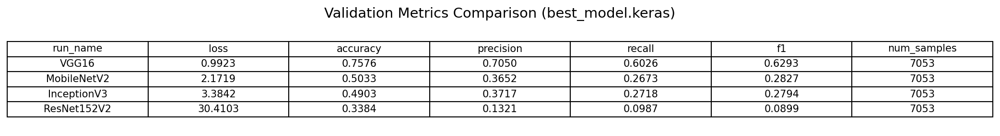

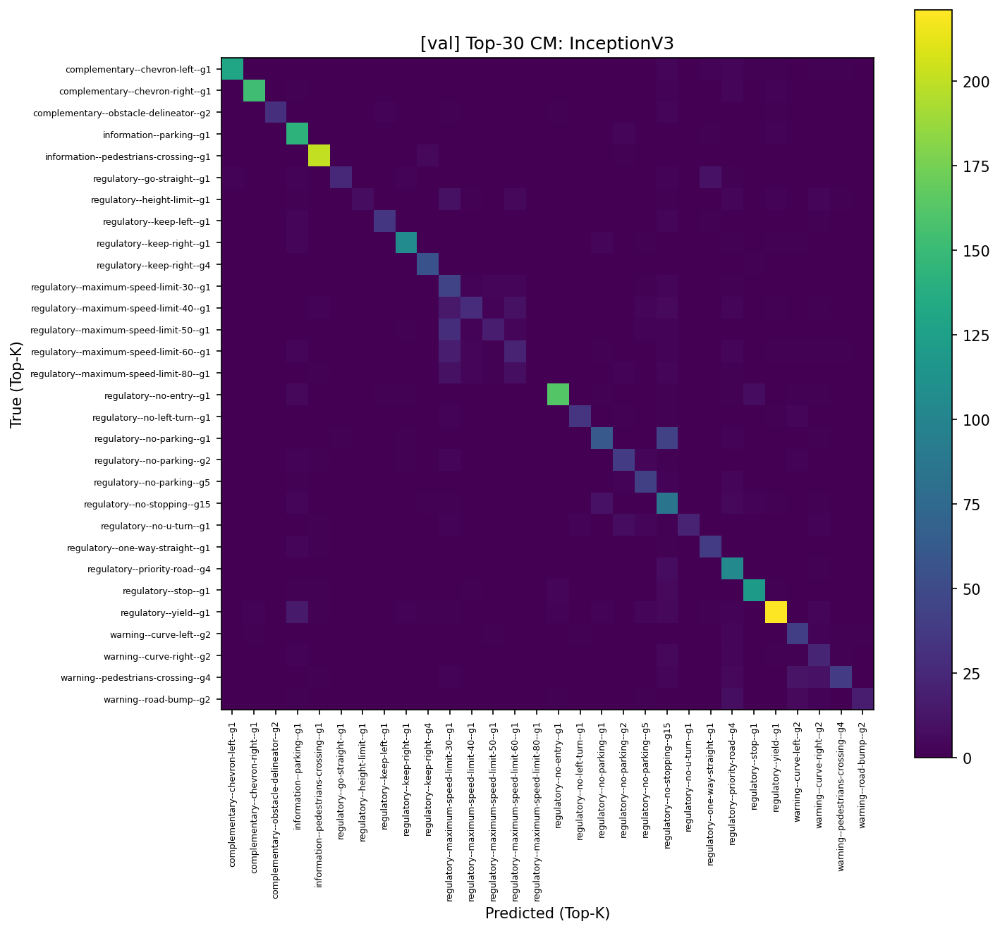

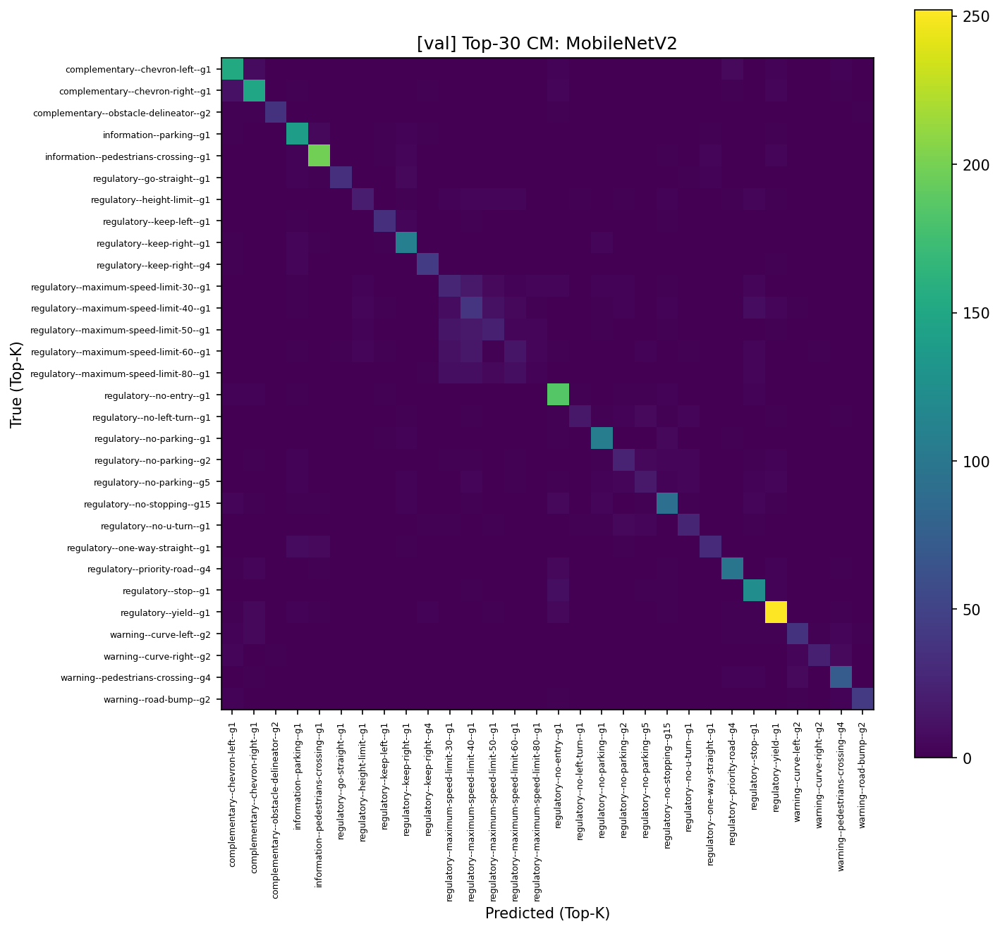

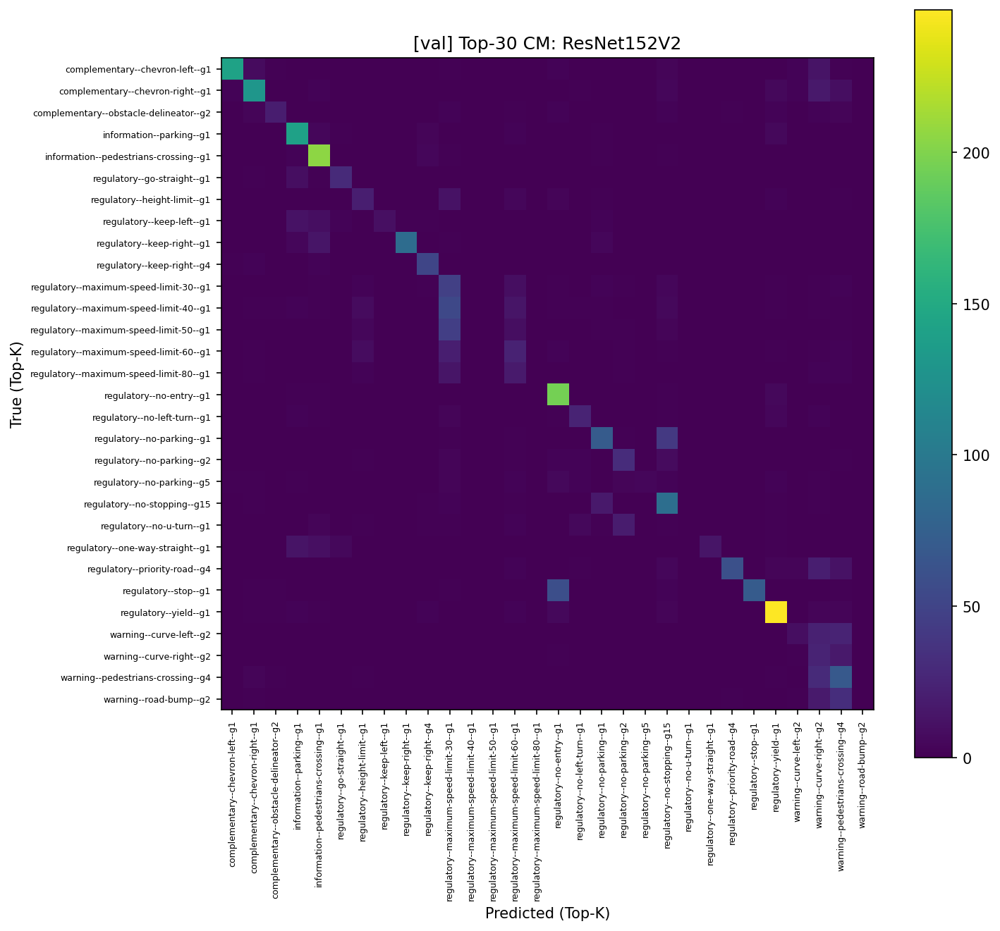

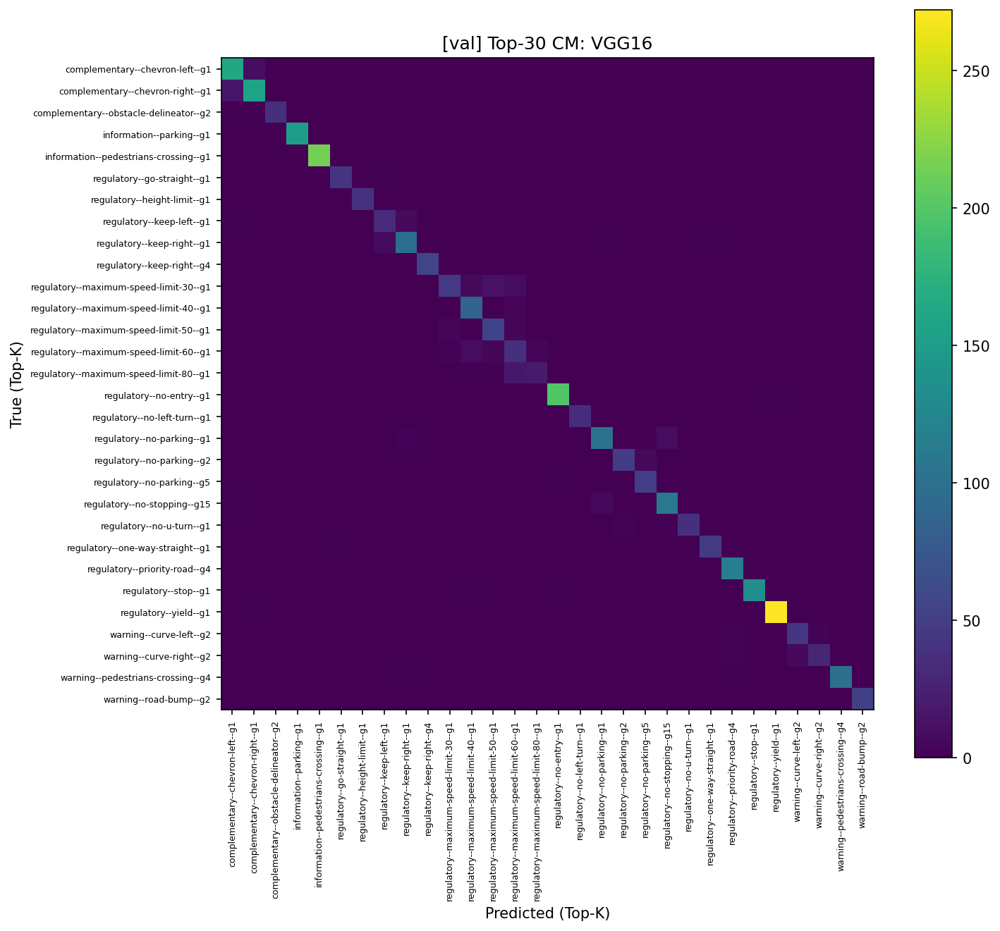

Test ranking (top 5):
                          run_dir     run_name       loss  accuracy  \
0        outputs/train_runs/VGG16        VGG16   1.013910  0.763930   
1  outputs/train_runs/InceptionV3  InceptionV3   3.476969  0.472565   
2  outputs/train_runs/MobileNetV2  MobileNetV2   2.192516  0.498228   
3  outputs/train_runs/ResNet152V2  ResNet152V2  30.292538  0.347228   

   precision    recall        f1  num_samples  r_loss  r_accuracy  \
0   0.690291  0.591641  0.617468         7053     1.0         1.0   
1   0.370762  0.258435  0.265544         7053     3.0         3.0   
2   0.346799  0.250165  0.265510         7053     2.0         2.0   
3   0.129527  0.098532  0.088560         7053     4.0         4.0   

   r_precision  r_recall  r_f1  rank_score  
0          1.0       1.0   1.0         5.0  
1          2.0       2.0   2.0        12.0  
2          3.0       3.0   3.0        13.0  
3          4.0       4.0   4.0        20.0  


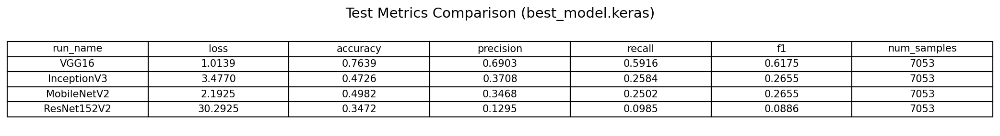

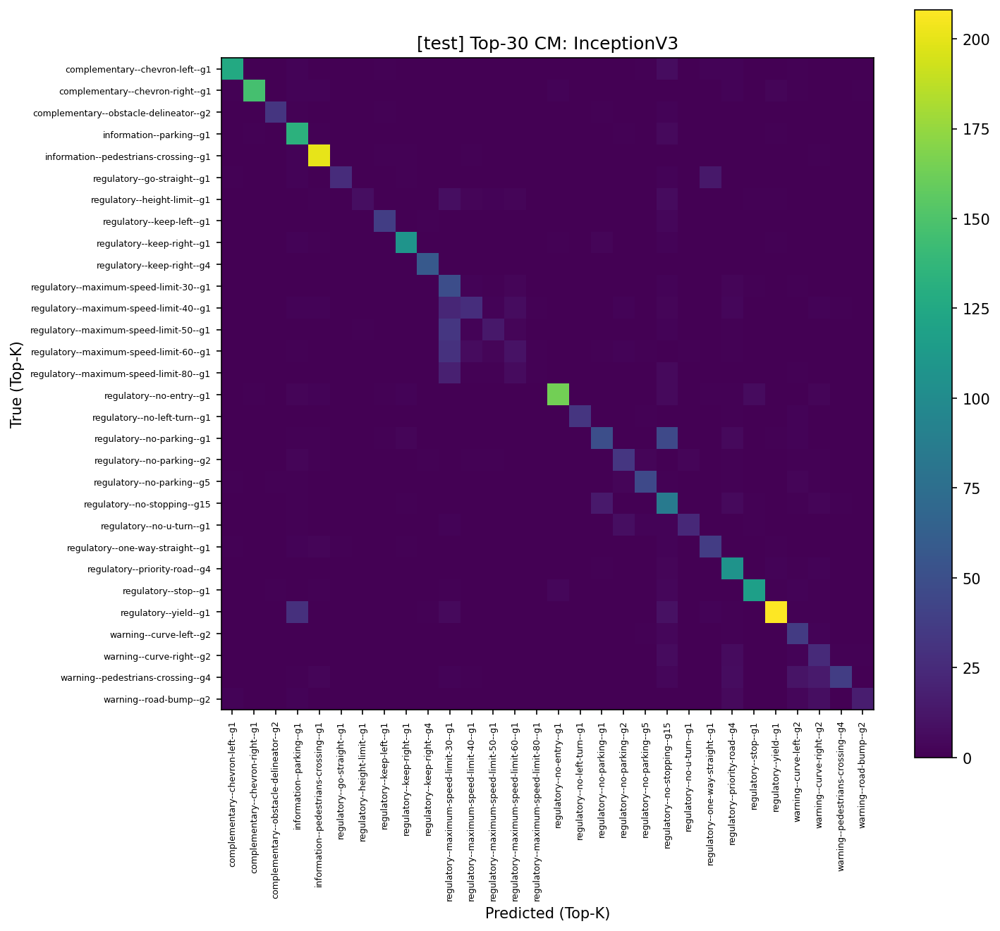

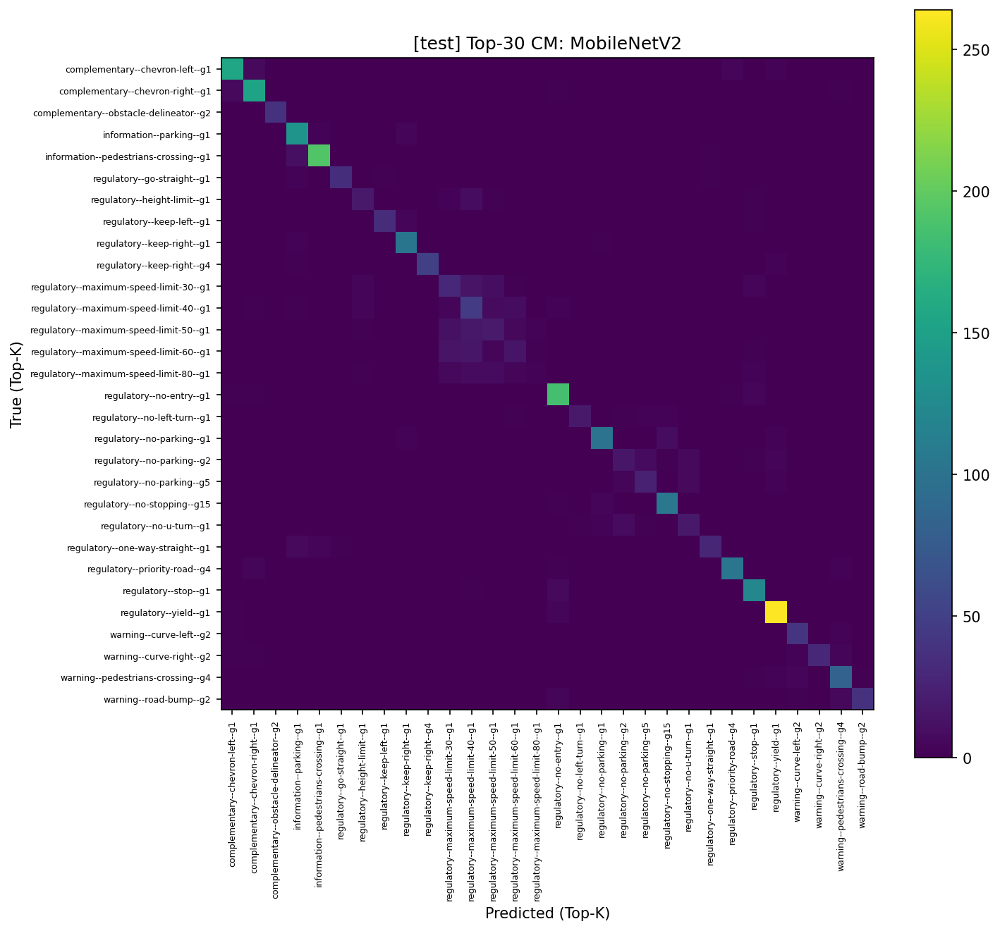

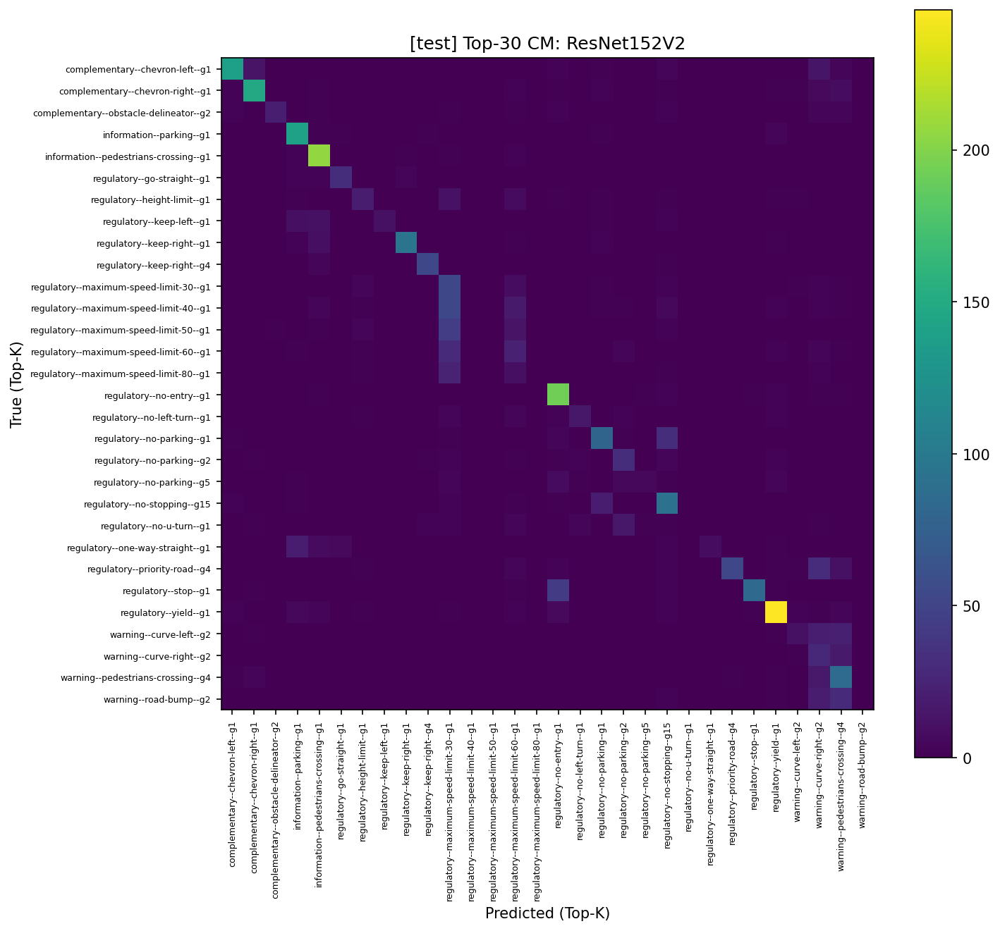

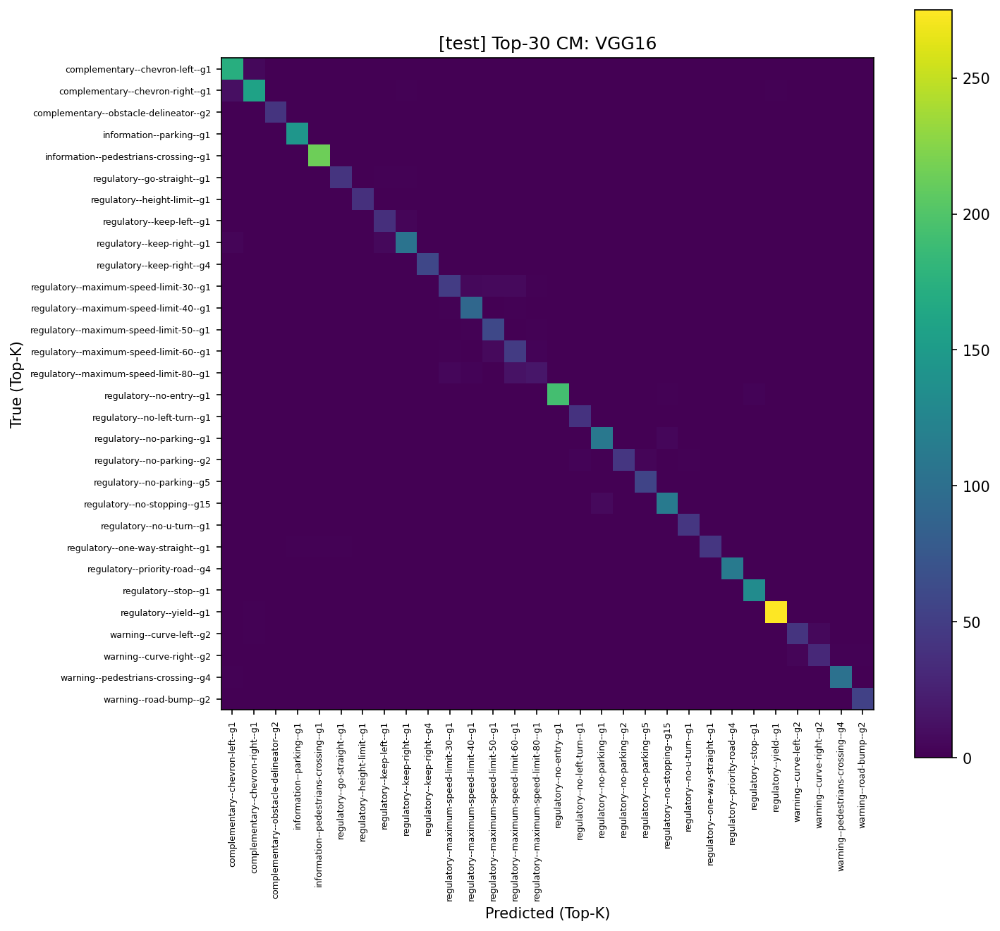

Notebook comparison artifacts saved to: outputs/train_runs/notebook_compare_20251215_190626


In [39]:
# Discover run directories.
run_dirs = discover_runs(RUNS_ROOT)  # Find runs.
print("Discovered runs:", [p.name for p in run_dirs])  # Print run names.

# Raise error if no runs found.
if len(run_dirs) == 0:
    raise RuntimeError(f"No valid run directories found under: {RUNS_ROOT}")  # Stop.

# Evaluate all models on validation split.
val_results = []  # Store results.
for rd in run_dirs:
    val_results.append(evaluate_one_split(rd, "val"))  # Evaluate val.

# Build validation metrics dataframe.
df_val = pd.DataFrame([{
    "run_dir": r["run_dir"],
    "run_name": r["run_name"],
    "loss": r["loss"],
    "accuracy": r["accuracy"],
    "precision": r["precision"],
    "recall": r["recall"],
    "f1": r["f1"],
    "num_samples": r["num_samples"],
} for r in val_results])  # Dataframe.

# Rank validation results.
df_val_ranked = rank_select_best(df_val, SELECTION_WEIGHTS)  # Rank.
print("Validation ranking (top 5):")  # Print header.
print(df_val_ranked.head())  # Print top rows.

# Save validation metrics table image.
val_table_path = NOTEBOOK_EXPORT_ROOT / "validation_metrics_table_notebook.png"  # Unique file.
plot_metrics_table(df_val_ranked, "Validation Metrics Comparison (best_model.keras)", val_table_path)  # Plot.

# Create Top-K confusion matrices for validation.
for r in val_results:
    cm_path = NOTEBOOK_EXPORT_ROOT / f"val_top{TOPK_CM}_cm_{r['run_name']}_notebook.png"  # Unique cm filename.
    plot_cm_topk(r["cm"], r["support"], r["class_names"], TOPK_CM, f"[val] Top-{TOPK_CM} CM: {r['run_name']}", cm_path)  # Plot.

# Evaluate all models on test split.
test_results = []  # Store results.
for rd in run_dirs:
    test_results.append(evaluate_one_split(rd, "test"))  # Evaluate test.

# Build test metrics dataframe.
df_test = pd.DataFrame([{
    "run_dir": r["run_dir"],
    "run_name": r["run_name"],
    "loss": r["loss"],
    "accuracy": r["accuracy"],
    "precision": r["precision"],
    "recall": r["recall"],
    "f1": r["f1"],
    "num_samples": r["num_samples"],
} for r in test_results])  # Dataframe.

# Rank test results.
df_test_ranked = rank_select_best(df_test, SELECTION_WEIGHTS)  # Rank.
print("Test ranking (top 5):")  # Print header.
print(df_test_ranked.head())  # Print top rows.

# Save test metrics table image.
test_table_path = NOTEBOOK_EXPORT_ROOT / "test_metrics_table_notebook.png"  # Unique file.
plot_metrics_table(df_test_ranked, "Test Metrics Comparison (best_model.keras)", test_table_path)  # Plot.

# Create Top-K confusion matrices for test.
for r in test_results:
    cm_path = NOTEBOOK_EXPORT_ROOT / f"test_top{TOPK_CM}_cm_{r['run_name']}_notebook.png"  # Unique cm filename.
    plot_cm_topk(r["cm"], r["support"], r["class_names"], TOPK_CM, f"[test] Top-{TOPK_CM} CM: {r['run_name']}", cm_path)  # Plot.

# Print where notebook artifacts are saved.
print("Notebook comparison artifacts saved to:", NOTEBOOK_EXPORT_ROOT)  # Print output location.


## Imports and notebook-safe plotting for infer_one_test_image_blip.py

In [40]:
# Enable inline plotting for Jupyter notebooks.
%matplotlib inline 
# Show plots inside notebook output.

# Import standard libraries for JSON, math, random, and process execution.
import json  # Read class_names.json.
import math  # Grid layout computations.
import random  # Random test image selection.
import subprocess  # Optional Windows viewer execution.
from pathlib import Path  # Path utilities.
from datetime import datetime  # Timestamp generation.

# Import numerical and dataframe utilities.
import numpy as np  # Numerical computations.
import pandas as pd  # CSV loading and filtering.

# Import Matplotlib for plotting.
import matplotlib.pyplot as plt  # Plotting API.
import matplotlib.patches as patches  # Rectangle patches for bounding boxes.

# Import PIL for image IO.
from PIL import Image  # Image loading and cropping.

# Import TensorFlow and Keras for model inference.
import tensorflow as tf  # TensorFlow core.
from tensorflow import keras  # Keras model loader.

# Import IPython display tools for showing saved images inline.
from IPython.display import Image as IPyImage, display  # Inline image display.

# Print environment status.
print("TensorFlow:", tf.__version__)  # Print TensorFlow version.


TensorFlow: 2.15.1


## Configuration with non-overwrite output directory

In [41]:
# Define the best model directory (same as your script default).
BEST_MODEL_DIR = Path("outputs/train_runs/best_performance_from_validation")  # Best model folder.

# Define required artifact paths.
MODEL_PATH = BEST_MODEL_DIR / "best_model.keras"  # Trained model file.
CLASS_NAMES_PATH = BEST_MODEL_DIR / "class_names.json"  # Class name mapping.
SPLIT_MANIFEST_PATH = BEST_MODEL_DIR / "split_manifest.csv"  # Split manifest.

# Create a unique output directory to avoid overwriting previous demo outputs.
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")  # Timestamp string.
OUTPUT_DIR = BEST_MODEL_DIR / f"demo_one_random_test_image_notebook_{timestamp}"  # Unique demo folder.
OUTPUT_DIR.mkdir(parents=True, exist_ok=False)  # Create folder and prevent overwrite.

# Define model input size.
IMG_SIZE = (224, 224)  # Model input resolution.

# Define confidence threshold for filtering predictions.
CONF_THRESH = 0.0  # Keep all predictions by default.

# Define size thresholds based on bbox area ratio.
NEAR_THRESH = 0.08  # Threshold for "near".
FAR_THRESH = 0.02  # Threshold for "far".

# Define number of alternative labels to mention in text.
TOPK_FOR_TEXT = 3  # Top-K alternatives.

# Define crop grid layout.
CROP_GRID_COLS = 6  # Columns for crop grid.

# Define bounding box drawing style.
BOX_COLOR = "red"  # BBox edge color.
BOX_LINEWIDTH = 2.5  # BBox line width.
BOX_FILL = False  # Do not fill inside the box.

# Define font sizes for plots.
TITLE_FONTSIZE = 20  # Title font size.
CROP_LABEL_FONTSIZE = 14  # Crop label font size.
DESC_FONTSIZE = 14  # Description text font size.

# Define BLIP model name.
BLIP_MODEL_NAME = "Salesforce/blip-image-captioning-base"  # BLIP model id.

# Optional: enable Windows blocking viewer for WSL (off by default in notebook).
USE_WINDOWS_BLOCKING_VIEWER = False  # Set True only if you want WinForms viewer.

# Print configuration paths.
print("MODEL_PATH:", MODEL_PATH)  # Print model path.
print("CLASS_NAMES_PATH:", CLASS_NAMES_PATH)  # Print class names path.
print("SPLIT_MANIFEST_PATH:", SPLIT_MANIFEST_PATH)  # Print manifest path.
print("OUTPUT_DIR:", OUTPUT_DIR)  # Print unique output dir.


MODEL_PATH: outputs/train_runs/best_performance_from_validation/best_model.keras
CLASS_NAMES_PATH: outputs/train_runs/best_performance_from_validation/class_names.json
SPLIT_MANIFEST_PATH: outputs/train_runs/best_performance_from_validation/split_manifest.csv
OUTPUT_DIR: outputs/train_runs/best_performance_from_validation/demo_one_random_test_image_notebook_20251215_191707


## GPU memory growth

In [42]:
# Enable GPU memory growth to reduce out-of-memory issues.
def enable_memory_growth() -> None:
    # Try enabling memory growth for all physical GPUs.
    try:
        gpus = tf.config.list_physical_devices("GPU")  # List GPUs.
        if gpus:  # If GPUs exist.
            for g in gpus:  # Iterate GPUs.
                tf.config.experimental.set_memory_growth(g, True)  # Enable growth.
        print("GPU memory growth enabled:", bool(gpus))  # Print status.
    except Exception as e:
        print("[WARN] Could not enable memory growth:", e)  # Warn if fails.

# Run memory growth configuration.
enable_memory_growth()  # Apply configuration.


GPU memory growth enabled: True


## Helper functions (copied logic, notebook-safe)

In [43]:
# Load class names from JSON file.
def load_class_names(path: Path) -> list[str]:
    # Read JSON text and parse list.
    return json.loads(path.read_text(encoding="utf-8"))  # Return list.

# Clamp bbox coordinates to image boundaries.
def clamp_bbox(xmin, ymin, xmax, ymax, w, h):
    # Clamp each coordinate to valid pixel bounds.
    xmin = max(0, min(int(xmin), w - 1))  # Clamp xmin.
    ymin = max(0, min(int(ymin), h - 1))  # Clamp ymin.
    xmax = max(0, min(int(xmax), w - 1))  # Clamp xmax.
    ymax = max(0, min(int(ymax), h - 1))  # Clamp ymax.
    # Reject invalid boxes.
    if xmax <= xmin or ymax <= ymin:
        return None  # Return None for invalid bbox.
    # Return bbox tuple.
    return xmin, ymin, xmax, ymax  # Return clamped bbox.

# Preprocess crop image for model inference.
def preprocess_crop_for_model(crop_pil: Image.Image) -> np.ndarray:
    # Convert to RGB and resize to model input size.
    crop = crop_pil.convert("RGB").resize(IMG_SIZE)  # Resize crop.
    # Convert to normalized float array.
    arr = np.asarray(crop).astype(np.float32) / 255.0  # Normalize.
    # Add batch dimension.
    return np.expand_dims(arr, axis=0)  # Shape (1, H, W, 3).

# Infer relative size category based on bbox area ratio.
def infer_relative_size(bbox, img_w, img_h) -> str:
    # Unpack bbox coordinates.
    x1, y1, x2, y2 = bbox  # Coordinates.
    # Compute bbox area.
    bbox_area = (x2 - x1) * (y2 - y1)  # Area.
    # Compute image area.
    img_area = img_w * img_h  # Image area.
    # Compute ratio.
    ratio = bbox_area / img_area if img_area > 0 else 0.0  # Ratio.
    # Decide category based on thresholds.
    if ratio >= NEAR_THRESH:
        return "near"  # Near.
    if ratio <= FAR_THRESH:
        return "far"  # Far.
    return "medium"  # Medium.

# Infer horizontal position category based on bbox center.
def infer_position(bbox, img_w) -> str:
    # Unpack bbox coordinates.
    x1, _, x2, _ = bbox  # Use x coords only.
    # Compute bbox center x.
    cx = (x1 + x2) / 2.0  # Center x.
    # Return left, center, or right based on thirds of image width.
    if cx < img_w / 3:
        return "left"  # Left.
    if cx < 2 * img_w / 3:
        return "center"  # Center.
    return "right"  # Right.

# Generate a scene caption using BLIP.
def blip_caption(full_image_pil: Image.Image) -> str:
    # Import BLIP components.
    from transformers import BlipProcessor, BlipForConditionalGeneration  # BLIP classes.
    import torch  # Torch for device selection.
    # Select device.
    device = "cuda" if torch.cuda.is_available() else "cpu"  # Device selection.
    # Load processor and model.
    processor = BlipProcessor.from_pretrained(BLIP_MODEL_NAME)  # Processor.
    model = BlipForConditionalGeneration.from_pretrained(BLIP_MODEL_NAME).to(device)  # Model.
    # Prepare inputs.
    inputs = processor(images=full_image_pil.convert("RGB"), return_tensors="pt").to(device)  # Inputs.
    # Generate caption tokens.
    out = model.generate(**inputs, max_new_tokens=30)  # Generate.
    # Decode caption.
    caption = processor.decode(out[0], skip_special_tokens=True)  # Decode.
    # Return stripped caption.
    return caption.strip()  # Return caption.

# Build final narrative description.
def build_context_description(scene_caption: str, sign_descs: list[str], alt_sentences: list[str]) -> str:
    # Count number of sign descriptions.
    n = len(sign_descs)  # Number of signs.
    # Build base sentence.
    if n == 0:
        base = f"Scene: {scene_caption}. No traffic signs were detected."  # No sign case.
    elif n == 1:
        base = f"Scene: {scene_caption}. One traffic sign was detected: {sign_descs[0]}."  # One sign case.
    else:
        base = f"Scene: {scene_caption}. {n} traffic signs were detected: " + "; ".join(sign_descs) + "."  # Multi sign case.
    # Append alternative label sentences if any.
    if alt_sentences:
        base += " " + " ".join(alt_sentences)  # Append.
    # Return final text.
    return base  # Return description.


## Plotting helpers (return figure, then show inline)

In [44]:
# Create the input image figure.
def make_figure_input(full_img: Image.Image) -> plt.Figure:
    # Create figure.
    fig = plt.figure(figsize=(10, 6))  # Figure size.
    # Show image.
    plt.imshow(full_img)  # Plot image.
    # Set title.
    plt.title("Selected Input Image", fontsize=TITLE_FONTSIZE)  # Title.
    # Hide axes.
    plt.axis("off")  # Hide axes.
    # Tight layout.
    plt.tight_layout()  # Layout.
    # Return figure.
    return fig  # Return figure.

# Create panel figure for classification and optional description.
def make_figure_panel(full_img: Image.Image, preds: list[dict], title: str, description_text: str | None = None) -> plt.Figure:
    # Compute number of crops.
    n_crops = len(preds)  # Number of crops.
    # Compute grid dimensions.
    cols = max(1, CROP_GRID_COLS)  # Number of columns.
    rows = max(1, math.ceil(n_crops / cols))  # Number of rows.
    # Compute figure height.
    fig_h = 6 + rows * 2.2 + (1.8 if description_text else 0)  # Figure height.
    # Create figure.
    fig = plt.figure(figsize=(14, fig_h))  # Create figure.

    # Create gridspec layout.
    if description_text:
        gs = fig.add_gridspec(3, 1, height_ratios=[4, rows * 1.8, 1.2])  # 3 rows.
        ax_img, ax_crops, ax_desc = [fig.add_subplot(gs[i]) for i in range(3)]  # Axes.
    else:
        gs = fig.add_gridspec(2, 1, height_ratios=[4, rows * 1.8])  # 2 rows.
        ax_img, ax_crops = [fig.add_subplot(gs[i]) for i in range(2)]  # Axes.
        ax_desc = None  # No description axis.

    # Plot full image.
    ax_img.imshow(full_img)  # Show full image.
    ax_img.set_title(title, fontsize=TITLE_FONTSIZE)  # Set title.
    ax_img.axis("off")  # Hide axes.

    # Draw bounding boxes.
    for p in preds:
        x1, y1, x2, y2 = p["bbox"]  # Unpack bbox.
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=BOX_FILL, linewidth=BOX_LINEWIDTH, edgecolor=BOX_COLOR)  # Rectangle.
        ax_img.add_patch(rect)  # Add bbox.

    # Plot crops grid.
    ax_crops.axis("off")  # Hide axes.
    for i, p in enumerate(preds):
        r, c = divmod(i, cols)  # Row and column index.
        inset = ax_crops.inset_axes([c / cols + 0.01, 1 - (r + 1) / rows + 0.06, 1 / cols - 0.02, 1 / rows - 0.1])  # Inset axis.
        inset.imshow(p["crop_pil"])  # Show crop.
        inset.axis("off")  # Hide axes.
        inset.set_title(f"'{p['pred_label']}'", fontsize=CROP_LABEL_FONTSIZE)  # Title label.

    # Plot description text if provided.
    if ax_desc is not None:
        ax_desc.axis("off")  # Hide axes.
        ax_desc.text(0.01, 0.5, description_text, fontsize=DESC_FONTSIZE, va="center", ha="left", wrap=True)  # Write text.

    # Tight layout and return.
    plt.tight_layout()  # Layout.
    return fig  # Return figure.

# Save a figure to disk and also show it inline in the notebook.
def save_and_display(fig: plt.Figure, save_path: Path, dpi: int = 250) -> None:
    # Ensure parent directory exists.
    save_path.parent.mkdir(parents=True, exist_ok=True)  # Create folder.
    # Save figure.
    fig.savefig(save_path, dpi=dpi)  # Save PNG.
    # Close figure to free memory.
    plt.close(fig)  # Close.
    # Display the saved PNG inline.
    display(IPyImage(filename=str(save_path)))  # Display inline.
    # Print saved path.
    print("[SAVED]", save_path)  # Print.


## Main demo pipeline (creates and shows 3 images in notebook)

/home/kyuchan/venvs/tf_gpu/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


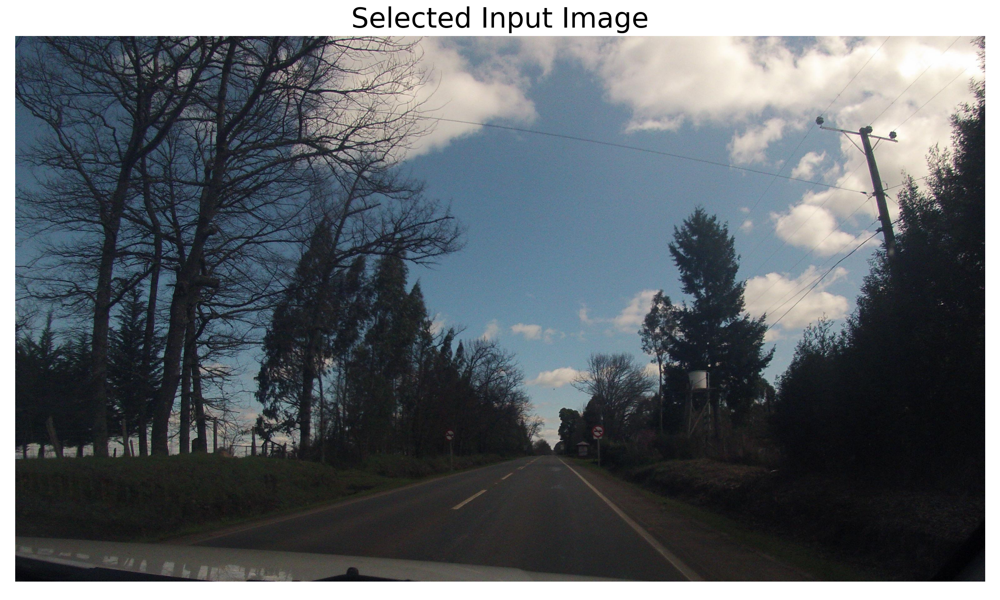

[SAVED] outputs/train_runs/best_performance_from_validation/demo_one_random_test_image_notebook_20251215_191707/01_input_full_image.png


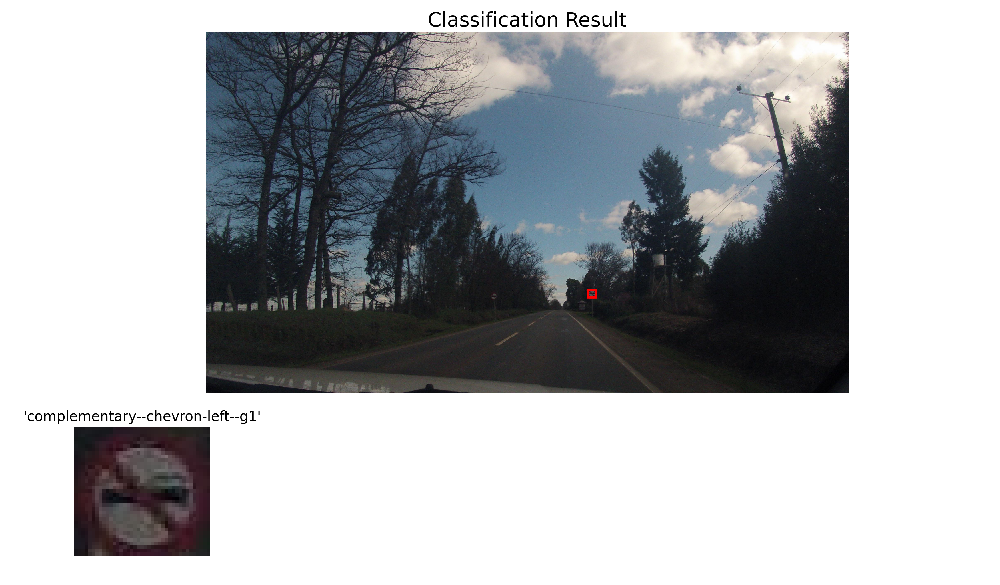

[SAVED] outputs/train_runs/best_performance_from_validation/demo_one_random_test_image_notebook_20251215_191707/02_classification_panel.png


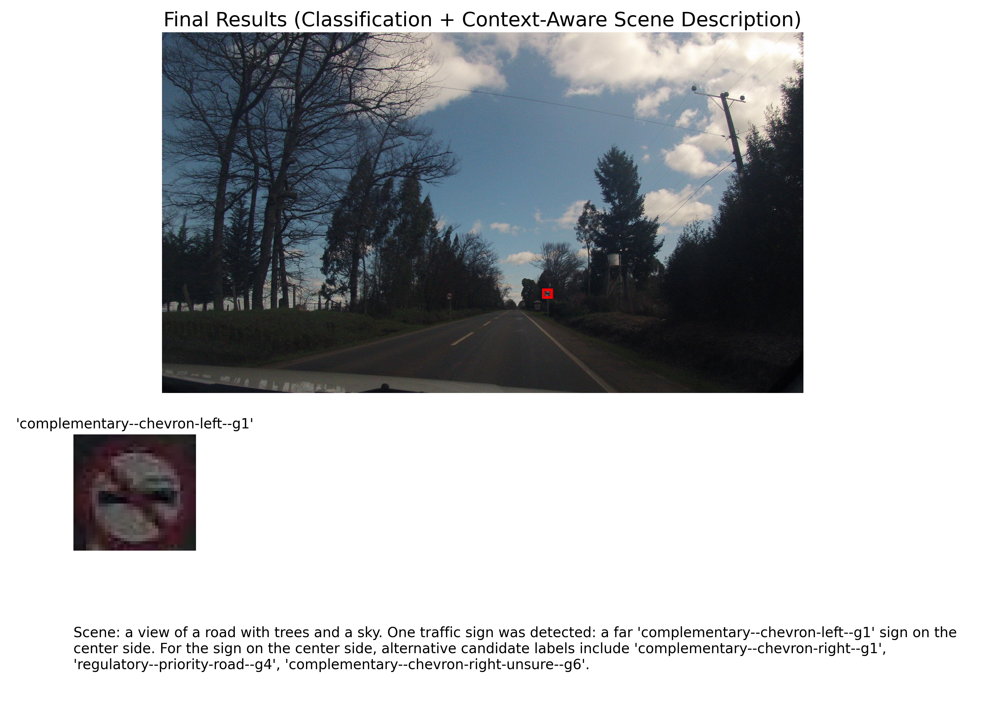

[SAVED] outputs/train_runs/best_performance_from_validation/demo_one_random_test_image_notebook_20251215_191707/03_classification_panel_with_description.png
Chosen image: data/raw/mtsd_extracted/Dataset/images/9cTw6NsErFcoUN8fx2KZnQ.jpg
BLIP caption: a view of a road with trees and a sky
Context-aware description: Scene: a view of a road with trees and a sky. One traffic sign was detected: a far 'complementary--chevron-left--g1' sign on the center side. For the sign on the center side, alternative candidate labels include 'complementary--chevron-right--g1', 'regulatory--priority-road--g4', 'complementary--chevron-right-unsure--g6'.
Demo outputs saved to: outputs/train_runs/best_performance_from_validation/demo_one_random_test_image_notebook_20251215_191707


In [45]:
# Validate required files exist before running demo.
if not MODEL_PATH.exists():
    raise FileNotFoundError(f"Model not found: {MODEL_PATH}")  # Stop if model missing.
if not CLASS_NAMES_PATH.exists():
    raise FileNotFoundError(f"class_names.json not found: {CLASS_NAMES_PATH}")  # Stop if missing.
if not SPLIT_MANIFEST_PATH.exists():
    raise FileNotFoundError(f"split_manifest.csv not found: {SPLIT_MANIFEST_PATH}")  # Stop if missing.

# Load trained classifier and class name mapping.
model = keras.models.load_model(MODEL_PATH)  # Load trained model.
class_names = load_class_names(CLASS_NAMES_PATH)  # Load class names list.

# Load split manifest.
df = pd.read_csv(SPLIT_MANIFEST_PATH)  # Read manifest CSV.
df_test = df[df["new_split"].astype(str) == "test"].copy()  # Filter test split.

# Raise error if no test rows exist.
if len(df_test) == 0:
    raise ValueError("No test rows found in split_manifest.csv.")  # Stop.

# Choose one random full image from test split.
image_paths = df_test["image_path"].dropna().astype(str).unique().tolist()  # Unique full images.
chosen_image_path = Path(random.choice(image_paths))  # Pick one random image.

# Raise error if the chosen image file does not exist.
if not chosen_image_path.exists():
    raise FileNotFoundError(f"Chosen image does not exist: {chosen_image_path}")  # Stop.

# Filter rows corresponding to this chosen image.
df_img = df_test[df_test["image_path"].astype(str) == str(chosen_image_path)].copy()  # Rows for chosen image.

# Load the full image.
full_img = Image.open(chosen_image_path).convert("RGB")  # Load full image.
W, H = full_img.size  # Image dimensions.

# Generate BLIP caption from full image.
scene_caption = blip_caption(full_img)  # BLIP caption.
(OUTPUT_DIR / "scene_caption.txt").write_text(scene_caption + "\n", encoding="utf-8")  # Save caption.

# Initialize containers for predictions and description fragments.
preds = []  # List of dicts for visualization.
sign_descs = []  # List of sign phrases.
alt_sentences = []  # List of alternative label sentences.

# Iterate over all bbox rows for the chosen image.
for _, row in df_img.iterrows():
    # Read bbox coordinates.
    xmin, ymin, xmax, ymax = row.get("xmin"), row.get("ymin"), row.get("xmax"), row.get("ymax")  # BBox fields.
    # Skip if bbox is missing.
    if any(pd.isna(v) for v in [xmin, ymin, xmax, ymax]):
        continue  # Skip.
    # Clamp bbox to image boundaries.
    bbox = clamp_bbox(xmin, ymin, xmax, ymax, W, H)  # Clamp.
    if bbox is None:
        continue  # Skip invalid bbox.

    # Crop sign image.
    crop = full_img.crop(bbox)  # Crop patch.

    # Run model inference for this crop.
    probs = model.predict(preprocess_crop_for_model(crop), verbose=0)[0]  # Probabilities.
    pred_id = int(np.argmax(probs))  # Predicted class id.
    pred_conf = float(probs[pred_id])  # Confidence.

    # Apply confidence threshold.
    if pred_conf < CONF_THRESH:
        continue  # Skip low confidence.

    # Get predicted label string.
    pred_label = class_names[pred_id]  # Label.

    # Compute size and position descriptors.
    size_desc = infer_relative_size(bbox, W, H)  # Size category.
    pos_desc = infer_position(bbox, W)  # Position category.

    # Add sign description phrase.
    sign_descs.append(f"a {size_desc} '{pred_label}' sign on the {pos_desc} side")  # Phrase.

    # Build alternative label list (top-K, excluding best).
    top_ids = np.argsort(probs)[::-1][1:TOPK_FOR_TEXT + 1]  # Alternative ids.
    alt_labels = [f"'{class_names[i]}'" for i in top_ids]  # Alternative labels.
    if alt_labels:
        alt_sentences.append(f"For the sign on the {pos_desc} side, alternative candidate labels include {', '.join(alt_labels)}.")  # Sentence.

    # Store prediction info for visualization.
    preds.append({"bbox": bbox, "crop_pil": crop, "pred_label": pred_label})  # Append.

# Build final context-aware description text.
context_text = build_context_description(scene_caption, sign_descs, alt_sentences)  # Final text.
(OUTPUT_DIR / "context_aware_description.txt").write_text(context_text + "\n", encoding="utf-8")  # Save text.

# Create and save three figures, then display inline in notebook.
p1 = OUTPUT_DIR / "01_input_full_image.png"  # Figure 1 path.
p2 = OUTPUT_DIR / "02_classification_panel.png"  # Figure 2 path.
p3 = OUTPUT_DIR / "03_classification_panel_with_description.png"  # Figure 3 path.

fig1 = make_figure_input(full_img)  # Create figure 1.
save_and_display(fig1, p1)  # Save and display.

fig2 = make_figure_panel(full_img, preds, "Classification Result")  # Create figure 2.
save_and_display(fig2, p2)  # Save and display.

fig3 = make_figure_panel(full_img, preds, "Final Results (Classification + Context-Aware Scene Description)", context_text)  # Create figure 3.
save_and_display(fig3, p3)  # Save and display.

# Optionally open images sequentially in Windows blocking viewer.
if USE_WINDOWS_BLOCKING_VIEWER:
    open_png_in_windows_blocking(p1, "Selected Input Image")  # Show 1.
    open_png_in_windows_blocking(p2, "Classification Result")  # Show 2.
    open_png_in_windows_blocking(p3, "Final Results")  # Show 3.

# Print short summary to notebook output.
print("Chosen image:", chosen_image_path)  # Print chosen image path.
print("BLIP caption:", scene_caption)  # Print caption.
print("Context-aware description:", context_text)  # Print description.
print("Demo outputs saved to:", OUTPUT_DIR)  # Print output directory.
